### Baselines

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.models as models
import torchvision.transforms as transforms
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import torch.nn.functional as F
import matplotlib.pyplot as plt
from tqdm import tqdm
from torch.utils.data import DataLoader, Dataset
from PIL import Image
import os
import random
import timm
import numpy as np
import json

device = "cuda" if torch.cuda.is_available() else "cpu"

weights = models.ResNet50_Weights.DEFAULT
transform = weights.transforms()

train_dataset = datasets.STL10(
    root="./data", split="train", download=True, transform=transform
)
test_dataset = datasets.STL10(
    root="./data", split="test", download=True, transform=transform
)

In [3]:
BATCH_SIZE = 128
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

In [31]:
resnet = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
for param in resnet.parameters():
    param.requires_grad = False
resnet.fc = nn.Linear(resnet.fc.in_features, 10)
resnet = resnet.to(device)

In [67]:
resnet_optimizer = optim.Adam(resnet.fc.parameters(), lr=1e-3)
criterion = nn.CrossEntropyLoss()

resnet_train_losses = []
resnet_test_losses = []
resnet_train_accs = []
resnet_test_accs = []

NUM_EPOCHS = 3
for epoch in range(NUM_EPOCHS):
    resnet.train()
    running_loss = 0.0
    correct_train = 0
    total_train = 0

    train_pbar = tqdm(
        train_loader, desc=f"Epoch {epoch+1}/{NUM_EPOCHS} [ResNet Training]"
    )
    for data, target in train_pbar:
        data, target = data.to(device), target.to(device)

        resnet_optimizer.zero_grad()
        output = resnet(data)
        loss = criterion(output, target)
        loss.backward()
        resnet_optimizer.step()

        running_loss += loss.item()
        _, predicted = torch.max(output.data, 1)
        total_train += target.size(0)
        correct_train += (predicted == target).sum().item()
        train_pbar.set_postfix(
            {
                "loss": f"{running_loss/len(train_loader):.4f}",
                "acc": f"{100 * correct_train / total_train:.2f}%",
            }
        )

    epoch_train_loss = running_loss / len(train_loader)
    epoch_train_acc = correct_train / total_train
    resnet_train_losses.append(epoch_train_loss)
    resnet_train_accs.append(epoch_train_acc)

    resnet.eval()
    test_loss = 0.0
    correct_test = 0
    total_test = 0
    with torch.no_grad():
        test_pbar = tqdm(
            test_loader, desc=f"Epoch {epoch+1}/{NUM_EPOCHS} [ResNet Testing]"
        )
        for data, target in test_pbar:
            data, target = data.to(device), target.to(device)
            output = resnet(data)
            loss = criterion(output, target)
            test_loss += loss.item()

            _, predicted = torch.max(output.data, 1)
            total_test += target.size(0)
            correct_test += (predicted == target).sum().item()
            test_pbar.set_postfix(
                {
                    "loss": f"{test_loss/len(test_loader):.4f}",
                    "acc": f"{100 * correct_test / total_test:.2f}%",
                }
            )

    epoch_test_loss = test_loss / len(test_loader)
    epoch_test_acc = correct_test / total_test
    resnet_test_losses.append(epoch_test_loss)
    resnet_test_accs.append(epoch_test_acc)

    print(
        f"Epoch {epoch+1} Summary -> Train Acc: {epoch_train_acc*100:.2f}% | Test Acc: {epoch_test_acc*100:.2f}%"
    )

Epoch 1/3 [ResNet Testing]: 100%|██████████| 63/63 [00:29<00:00,  2.14it/s, loss=0.6749, acc=94.19%]


Epoch 1 Summary -> Train Acc: 79.66% | Test Acc: 94.19%


Epoch 2/3 [ResNet Testing]: 100%|██████████| 63/63 [00:35<00:00,  1.78it/s, loss=0.3539, acc=95.41%]


Epoch 2 Summary -> Train Acc: 95.76% | Test Acc: 95.41%


Epoch 3/3 [ResNet Testing]: 100%|██████████| 63/63 [00:29<00:00,  2.13it/s, loss=0.2587, acc=96.10%]

Epoch 3 Summary -> Train Acc: 96.60% | Test Acc: 96.10%


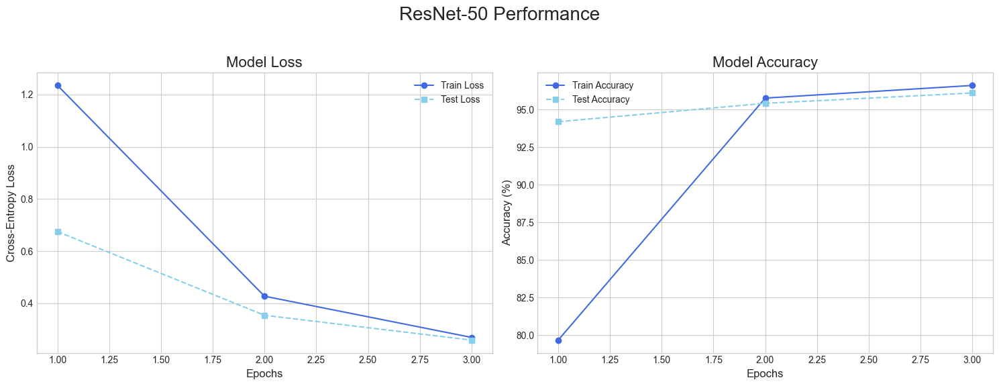

In [68]:
epochs = range(1, NUM_EPOCHS + 1)
plt.style.use("seaborn-v0_8-whitegrid")
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
fig.suptitle("ResNet-50 Performance", fontsize=20)

# Plotting Loss
ax1.plot(epochs, resnet_train_losses, "o-", label="Train Loss", color="royalblue")
ax1.plot(epochs, resnet_test_losses, "s--", label="Test Loss", color="skyblue")
ax1.set_title("Model Loss", fontsize=16)
ax1.set_xlabel("Epochs", fontsize=12)
ax1.set_ylabel("Cross-Entropy Loss", fontsize=12)
ax1.legend()

# Plotting Accuracy
ax2.plot(
    epochs,
    [acc * 100 for acc in resnet_train_accs],
    "o-",
    label="Train Accuracy",
    color="royalblue",
)
ax2.plot(
    epochs,
    [acc * 100 for acc in resnet_test_accs],
    "s--",
    label="Test Accuracy",
    color="skyblue",
)
ax2.set_title("Model Accuracy", fontsize=16)
ax2.set_xlabel("Epochs", fontsize=12)
ax2.set_ylabel("Accuracy (%)", fontsize=12)
ax2.legend()

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

In [3]:
# torch.save(resnet.state_dict(), "resnet50_stl10.pth")

resnet = models.resnet50(weights=None)
for param in resnet.parameters():
    param.requires_grad = False
resnet.fc = nn.Linear(resnet.fc.in_features, 10)
resnet.load_state_dict(torch.load("resnet50_stl10.pth"))
resnet = resnet.to(device)

resnet.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [11]:
vit = timm.create_model('vit_small_patch16_224', pretrained=True)

for param in vit.parameters():
    param.requires_grad = False
vit.head = nn.Linear(vit.head.in_features, 10)
vit = vit.to(device)

In [ ]:
vit_optimizer = optim.Adam(vit.head.parameters(), lr=1e-3)

vit_train_losses = []
vit_test_losses = []
vit_train_accs = []
vit_test_accs = []

NUM_EPOCHS = 2
for epoch in range(NUM_EPOCHS):
    vit.train()
    running_loss = 0.0
    correct_train = 0
    total_train = 0

    train_pbar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{NUM_EPOCHS} [ViT Training]")
    for data, target in train_pbar:
        data, target = data.to(device), target.to(device)

        vit_optimizer.zero_grad()
        output = vit(data)
        loss = criterion(output, target)
        loss.backward()
        vit_optimizer.step()

        running_loss += loss.item()
        _, predicted = torch.max(output.data, 1)
        total_train += target.size(0)
        correct_train += (predicted == target).sum().item()
        train_pbar.set_postfix(
            {
                "loss": f"{running_loss/len(train_loader):.4f}",
                "acc": f"{100 * correct_train / total_train:.2f}%",
            }
        )

    epoch_train_loss = running_loss / len(train_loader)
    epoch_train_acc = correct_train / total_train
    vit_train_losses.append(epoch_train_loss)
    vit_train_accs.append(epoch_train_acc)

    vit.eval()
    test_loss = 0.0
    correct_test = 0
    total_test = 0
    with torch.no_grad():
        test_pbar = tqdm(
            test_loader, desc=f"Epoch {epoch+1}/{NUM_EPOCHS} [ViT Testing]"
        )
        for data, target in test_pbar:
            data, target = data.to(device), target.to(device)
            output = vit(data)
            loss = criterion(output, target)
            test_loss += loss.item()

            _, predicted = torch.max(output.data, 1)
            total_test += target.size(0)
            correct_test += (predicted == target).sum().item()
            test_pbar.set_postfix(
                {
                    "loss": f"{test_loss/len(test_loader):.4f}",
                    "acc": f"{100 * correct_test / total_test:.2f}%",
                }
            )

    epoch_test_loss = test_loss / len(test_loader)
    epoch_test_acc = correct_test / total_test
    vit_test_losses.append(epoch_test_loss)
    vit_test_accs.append(epoch_test_acc)

    print(
        f"Epoch {epoch+1} Summary -> Train Acc: {epoch_train_acc*100:.2f}% | Test Acc: {epoch_test_acc*100:.2f}%"
    )

Epoch 1/2 [ViT Testing]: 100%|██████████| 63/63 [00:26<00:00,  2.38it/s, loss=0.1321, acc=96.80%]


Epoch 1 Summary -> Train Acc: 79.18% | Test Acc: 96.80%


Epoch 2/2 [ViT Testing]: 100%|██████████| 63/63 [00:34<00:00,  1.82it/s, loss=0.0927, acc=97.51%]

Epoch 2 Summary -> Train Acc: 97.58% | Test Acc: 97.51%


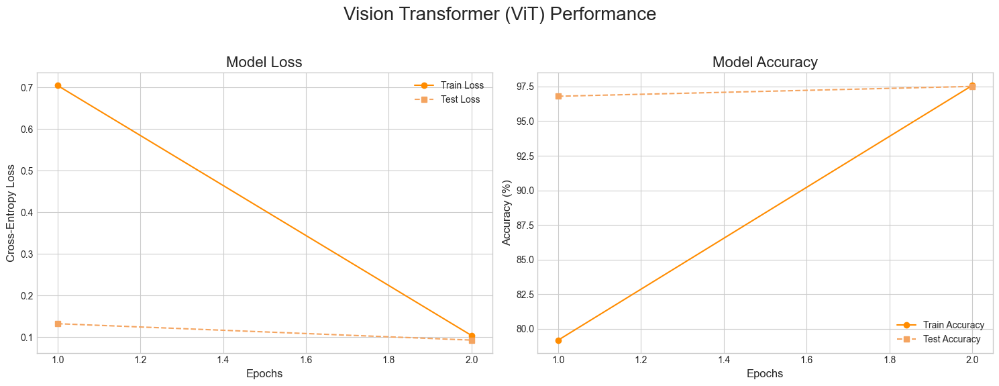

In [ ]:
epochs = range(1, NUM_EPOCHS + 1)
plt.style.use("seaborn-v0_8-whitegrid")
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
fig.suptitle("Vision Transformer (ViT) Performance", fontsize=20)

# Plotting Loss
ax1.plot(epochs, vit_train_losses, "o-", label="Train Loss", color="darkorange")
ax1.plot(epochs, vit_test_losses, "s--", label="Test Loss", color="sandybrown")
ax1.set_title("Model Loss", fontsize=16)
ax1.set_xlabel("Epochs", fontsize=12)
ax1.set_ylabel("Cross-Entropy Loss", fontsize=12)
ax1.legend()

# Plotting Accuracy
ax2.plot(
    epochs,
    [acc * 100 for acc in vit_train_accs],
    "o-",
    label="Train Accuracy",
    color="darkorange",
)
ax2.plot(
    epochs,
    [acc * 100 for acc in vit_test_accs],
    "s--",
    label="Test Accuracy",
    color="sandybrown",
)
ax2.set_title("Model Accuracy", fontsize=16)
ax2.set_xlabel("Epochs", fontsize=12)
ax2.set_ylabel("Accuracy (%)", fontsize=12)
ax2.legend()

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

In [4]:
# torch.save(vit.state_dict(), "vit_stl10.pth")

vit = timm.create_model('vit_small_patch16_224', pretrained=False)
for param in vit.parameters():
    param.requires_grad = False
vit.head = nn.Linear(vit.head.in_features, 10)
vit.load_state_dict(torch.load("vit_stl10.pth"))
vit = vit.to(device)

vit.eval()

VisionTransformer(
  (patch_embed): PatchEmbed(
    (proj): Conv2d(3, 384, kernel_size=(16, 16), stride=(16, 16))
    (norm): Identity()
  )
  (pos_drop): Dropout(p=0.0, inplace=False)
  (patch_drop): Identity()
  (norm_pre): Identity()
  (blocks): Sequential(
    (0): Block(
      (norm1): LayerNorm((384,), eps=1e-06, elementwise_affine=True)
      (attn): Attention(
        (qkv): Linear(in_features=384, out_features=1152, bias=True)
        (q_norm): Identity()
        (k_norm): Identity()
        (attn_drop): Dropout(p=0.0, inplace=False)
        (norm): Identity()
        (proj): Linear(in_features=384, out_features=384, bias=True)
        (proj_drop): Dropout(p=0.0, inplace=False)
      )
      (ls1): Identity()
      (drop_path1): Identity()
      (norm2): LayerNorm((384,), eps=1e-06, elementwise_affine=True)
      (mlp): Mlp(
        (fc1): Linear(in_features=384, out_features=1536, bias=True)
        (act): GELU(approximate='none')
        (drop1): Dropout(p=0.0, inplace=False

### Color Bias

In [ ]:
grayscale_transform = transforms.Compose(
    [
        transforms.Grayscale(num_output_channels=3),
        transform,
    ]
)
grayscale_test_dataset = datasets.STL10(
    root="./data", split="test", download=True, transform=grayscale_transform
)

grayscale_test_loader = DataLoader(
    grayscale_test_dataset, batch_size=BATCH_SIZE, shuffle=False
)

In [71]:
resnet.eval()
correct_test_resnet = 0
total_test_resnet = 0
with torch.no_grad():
    pbar_resnet = tqdm(
        grayscale_test_loader, desc="Evaluating ResNet-50 on Grayscale Test Set"
    )
    for data, target in pbar_resnet:
        data, target = data.to(device), target.to(device)
        output = resnet(data)
        _, predicted = torch.max(output.data, 1)
        total_test_resnet += target.size(0)
        correct_test_resnet += (predicted == target).sum().item()
        pbar_resnet.set_postfix(
            {"accuracy": f"{100 * correct_test_resnet / total_test_resnet:.2f}%"}
        )
resnet_grayscale_acc = 100 * correct_test_resnet / total_test_resnet
print(f"Accuracy of ResNet-50 on Grayscale Test Set: {resnet_grayscale_acc:.2f}%")

Evaluating ResNet-50 on Grayscale Test Set: 100%|██████████| 63/63 [00:34<00:00,  1.81it/s, accuracy=92.17%]

Accuracy of ResNet-50 on Grayscale Test Set: 92.17%


In [72]:
vit.eval()
correct_test_vit = 0
total_test_vit = 0
with torch.no_grad():
    pbar_vit = tqdm(grayscale_test_loader, desc="Evaluating ViT on Grayscale Test Set")
    for data, target in pbar_vit:
        data, target = data.to(device), target.to(device)
        output = vit(data)
        _, predicted = torch.max(output.data, 1)
        total_test_vit += target.size(0)
        correct_test_vit += (predicted == target).sum().item()
        pbar_vit.set_postfix(
            {"accuracy": f"{100 * correct_test_vit / total_test_vit:.2f}%"}
        )
vit_grayscale_acc = 100 * correct_test_vit / total_test_vit
print(f"Accuracy of ViT on Grayscale Test Set: {vit_grayscale_acc:.2f}%")

Evaluating ViT on Grayscale Test Set: 100%|██████████| 63/63 [00:29<00:00,  2.14it/s, accuracy=92.72%]

Accuracy of ViT on Grayscale Test Set: 92.72%


### Cue Conflict

In [5]:
import copy
from PIL import Image
from torchvision.transforms.functional import to_pil_image

cue_conflict_dir = "data/cue_conflict_dataset"
full_cue_conflict_dataset = datasets.ImageFolder(
    root=cue_conflict_dir,
    transform=transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
    ]),
)

class_names = full_cue_conflict_dataset.classes
num_samples_to_show = 4
styles = ['abstract', 'mosaic', 'rain_princess', 'starry_night']
if hasattr(resnet, 'zero_grad'):
    resnet.zero_grad()
if hasattr(vit, 'zero_grad'):
    vit.zero_grad()

import gc
gc.collect()
if 'cuda' in str(device):
    torch.cuda.empty_cache()

In [6]:
def denormalize_for_display(tensor, mean, std):
    """Denormalize a tensor that was normalized with ImageNet mean and std."""
    if not isinstance(mean, torch.Tensor):
        mean = torch.tensor(mean).view(-1, 1, 1)
    if not isinstance(std, torch.Tensor):
        std = torch.tensor(std).view(-1, 1, 1)

    denorm_tensor = tensor * std + mean
    return torch.clamp(denorm_tensor, 0, 1)


def display_image_properly(image_tensor):
    """Properly display an image tensor, handling both normalized and unnormalized cases."""
    IMAGENET_MEAN = [0.485, 0.456, 0.406]
    IMAGENET_STD = [0.229, 0.224, 0.225]

    img = image_tensor.clone()

    if img.min() < -0.5 or img.max() > 2.0:
        img = denormalize_for_display(img, IMAGENET_MEAN, IMAGENET_STD)
    elif img.max() > 1.0:
        img = torch.clamp(img / 255.0, 0, 1)
    else:
        img = torch.clamp(img, 0, 1)

    return img


def evaluate_model_on_style(
    model, style, full_dataset, device, batch_size, num_samples_to_show=4
):
    """
    Ultra clean evaluation function that doesn't interfere with model state.
    Returns results without any side effects.
    """
    # Create fresh dataset for this style
    style_dataset = copy.deepcopy(full_dataset)
    style_samples = [s for s in full_dataset.samples if f"style_{style}" in s[0]]
    style_dataset.samples = style_samples
    style_dataset.imgs = style_samples

    if not style_dataset.samples:
        return None

    # Create fresh dataloader
    style_loader = DataLoader(style_dataset, batch_size=batch_size, shuffle=False)

    # Ensure model is in eval mode
    model.eval()

    # Initialize counters
    shape_match_count = 0
    total_images = 0
    correct_samples = []
    incorrect_samples = []

    # Pure evaluation with no gradient computation
    with torch.no_grad():
        for data, target in style_loader:
            data, target = data.to(device), target.to(device)

            # Forward pass
            output = model(data)
            _, predicted = torch.max(output.data, 1)

            # Update counters
            shape_match_count += (predicted == target).sum().item()
            total_images += target.size(0)

            # Collect samples for visualization
            for i in range(data.size(0)):
                if (
                    predicted[i] == target[i]
                    and len(correct_samples) < num_samples_to_show
                ):
                    correct_samples.append(
                        (data[i].cpu(), predicted[i].cpu(), target[i].cpu())
                    )
                elif (
                    predicted[i] != target[i]
                    and len(incorrect_samples) < num_samples_to_show
                ):
                    incorrect_samples.append(
                        (data[i].cpu(), predicted[i].cpu(), target[i].cpu())
                    )

    return {
        "shape_match_count": shape_match_count,
        "total_images": total_images,
        "correct_samples": correct_samples,
        "incorrect_samples": incorrect_samples,
        "accuracy": (shape_match_count / total_images) * 100 if total_images > 0 else 0,
    }


EVALUATION
Starting evaluations...

--- Evaluating Style: ABSTRACT ---
  Evaluating ResNet-50...
  Evaluating ViT...
  Results: ResNet 27.00% | ViT 53.00%

--- Evaluating Style: MOSAIC ---
  Evaluating ResNet-50...
  Evaluating ViT...
  Results: ResNet 10.00% | ViT 19.00%

--- Evaluating Style: RAIN_PRINCESS ---
  Evaluating ResNet-50...
  Evaluating ViT...
  Results: ResNet 15.00% | ViT 69.00%

--- Evaluating Style: STARRY_NIGHT ---
  Evaluating ResNet-50...
  Evaluating ViT...
  Results: ResNet 10.00% | ViT 71.00%

FINAL SHAPE BIAS SUMMARY (ACROSS ALL STYLES)
ResNet-50 Total Shape Bias: 15.50% (62/400 correct)
Vision Transformer (ViT) Total Shape Bias: 53.00% (212/400 correct)

Detailed Breakdown by Style:
------------------------------------------------------------
       ABSTRACT: ResNet  27.00% ( 27/100) | ViT  53.00% ( 53/100)
         MOSAIC: ResNet  10.00% ( 10/100) | ViT  19.00% ( 19/100)
  RAIN_PRINCESS: ResNet  15.00% ( 15/100) | ViT  69.00% ( 69/100)
   STARRY_NIGHT: ResNe

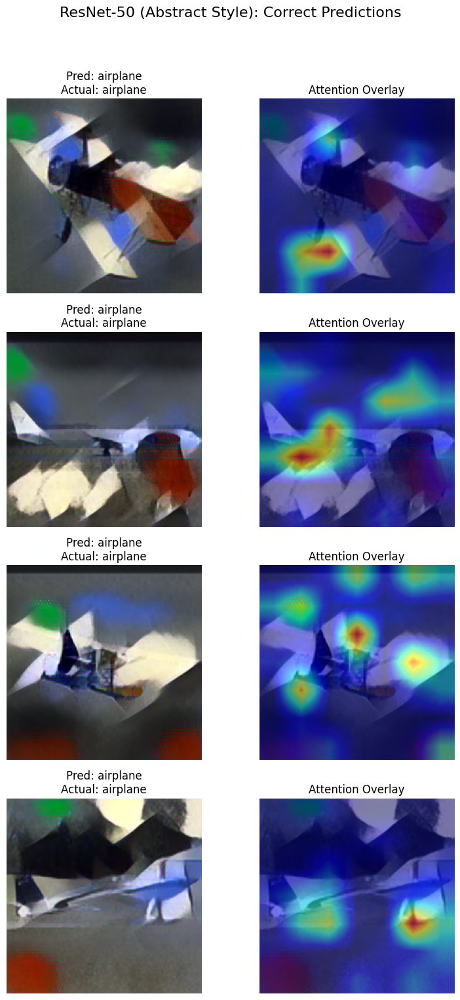

Generating attention maps for ResNet-50 (Abstract Style) incorrect predictions...


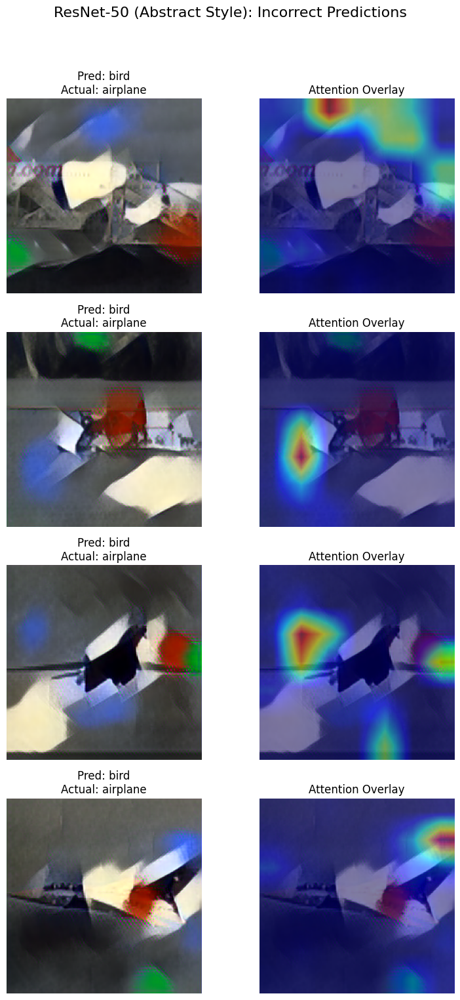

Generating attention maps for Vision Transformer (Abstract Style) correct predictions...


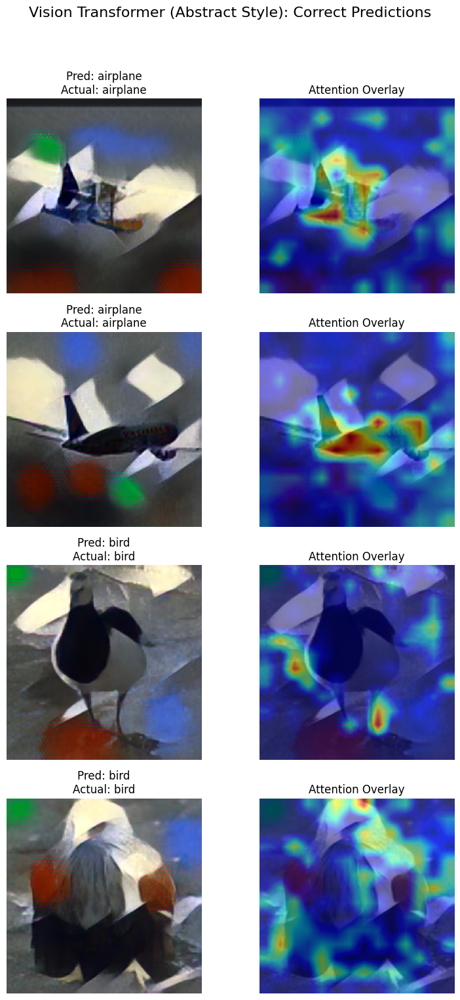

Generating attention maps for Vision Transformer (Abstract Style) incorrect predictions...


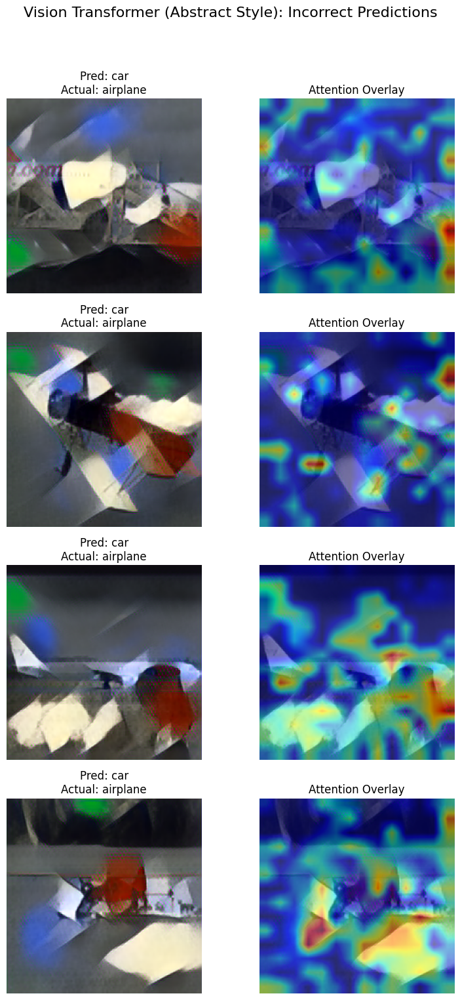


--- Visualizing Style: MOSAIC ---
Generating attention maps for ResNet-50 (Mosaic Style) correct predictions...


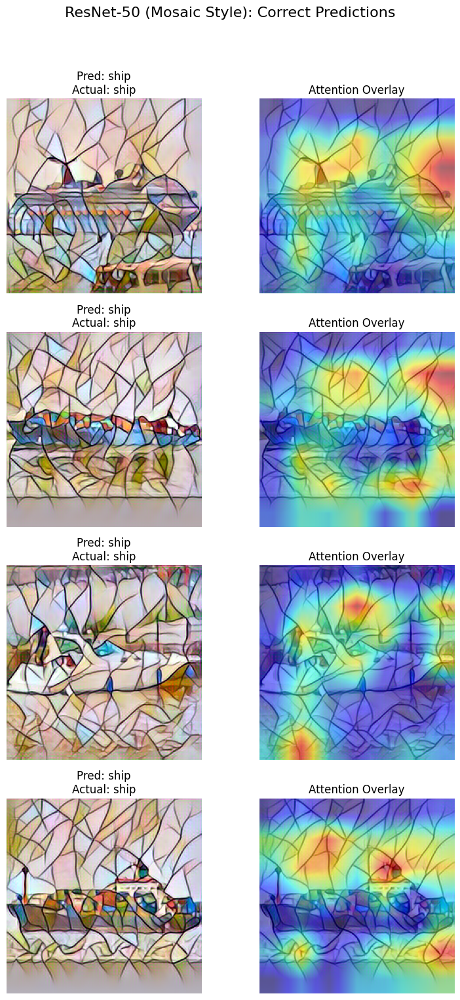

Generating attention maps for ResNet-50 (Mosaic Style) incorrect predictions...


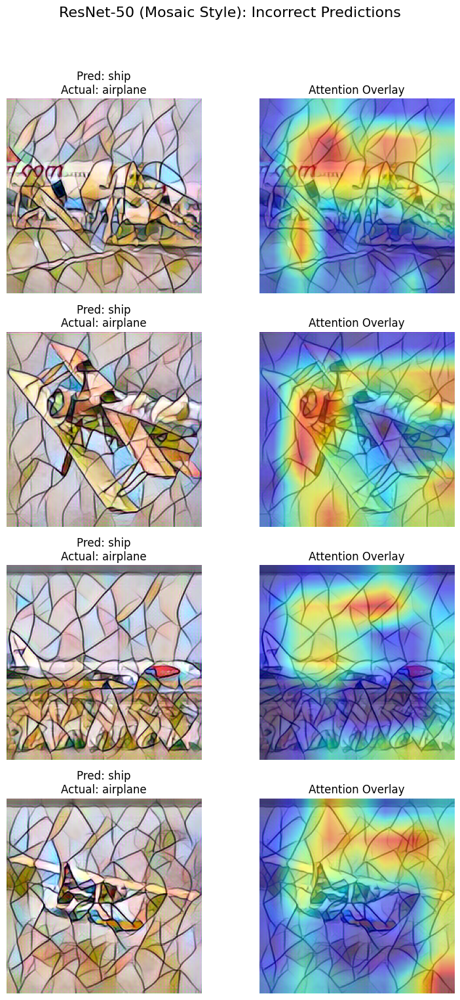

Generating attention maps for Vision Transformer (Mosaic Style) correct predictions...


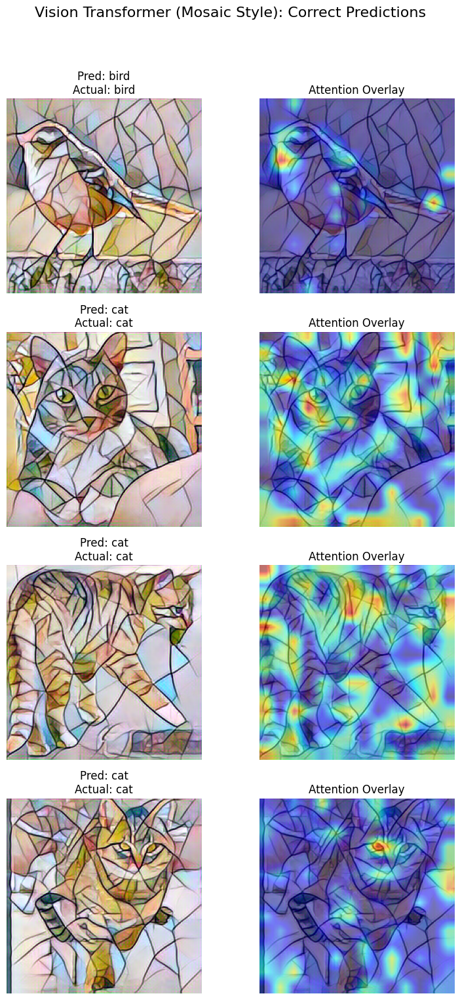

Generating attention maps for Vision Transformer (Mosaic Style) incorrect predictions...


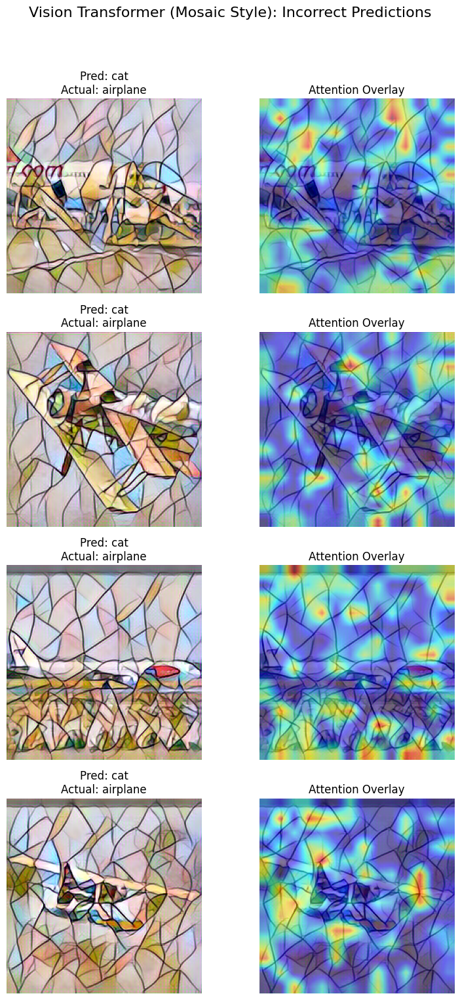


--- Visualizing Style: RAIN_PRINCESS ---
Generating attention maps for ResNet-50 (Rain_Princess Style) correct predictions...


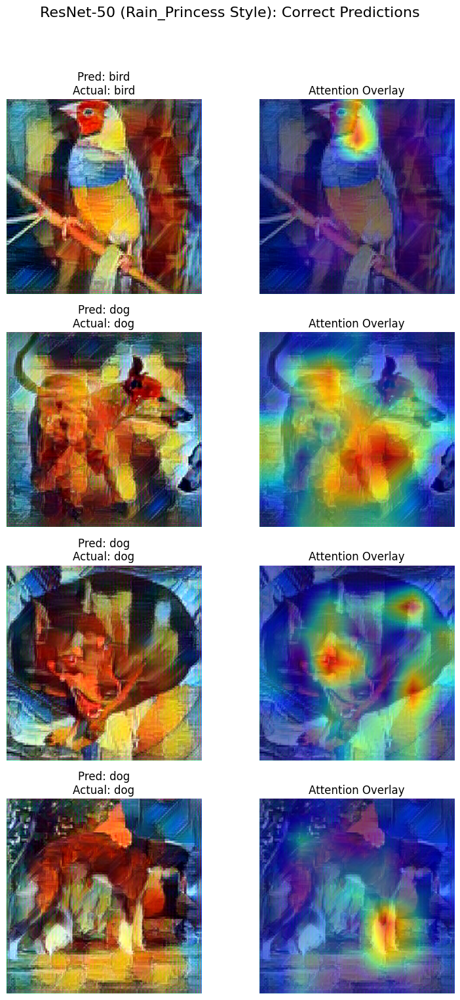

Generating attention maps for ResNet-50 (Rain_Princess Style) incorrect predictions...


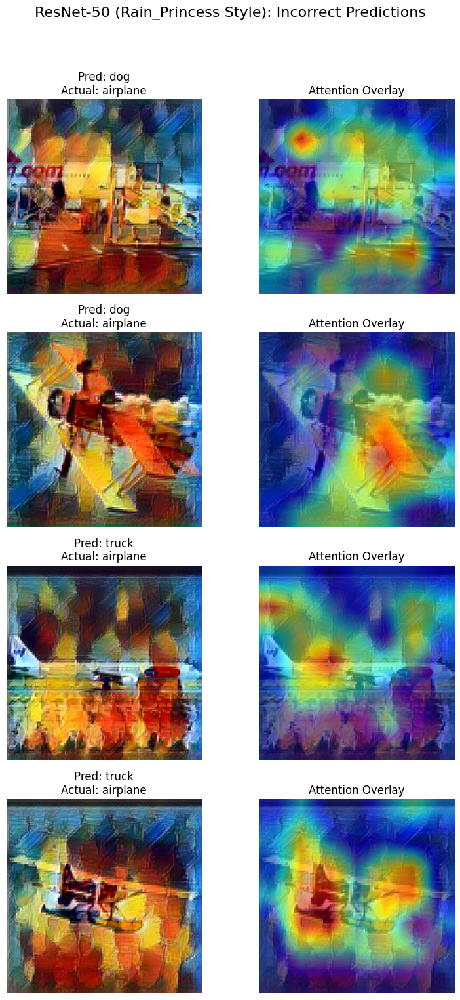

Generating attention maps for Vision Transformer (Rain_Princess Style) correct predictions...


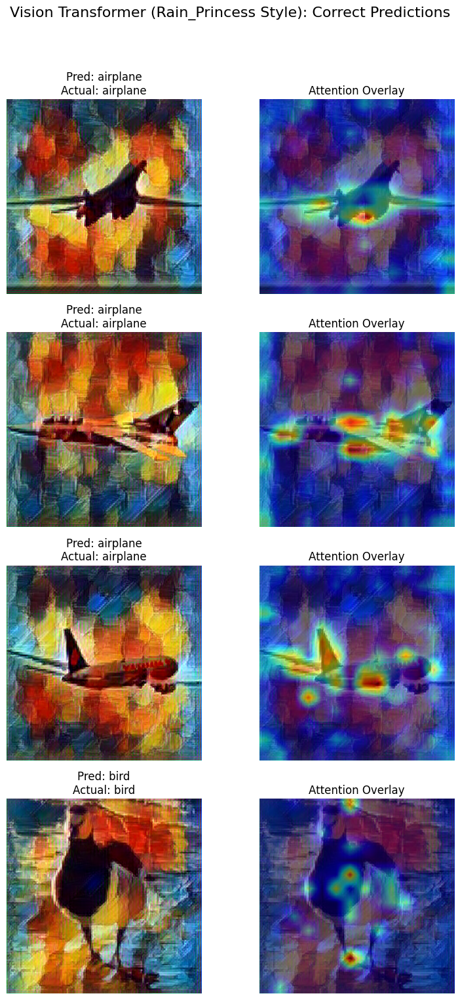

Generating attention maps for Vision Transformer (Rain_Princess Style) incorrect predictions...


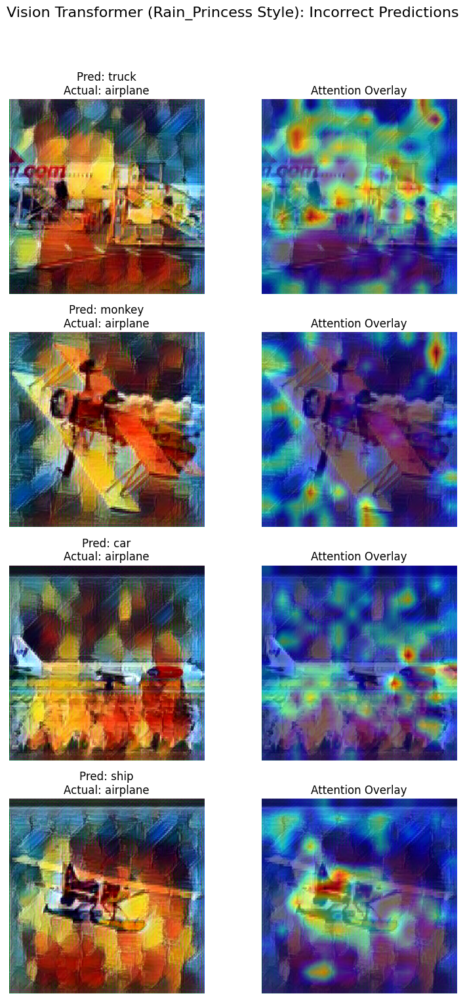


--- Visualizing Style: STARRY_NIGHT ---
Generating attention maps for ResNet-50 (Starry_Night Style) correct predictions...


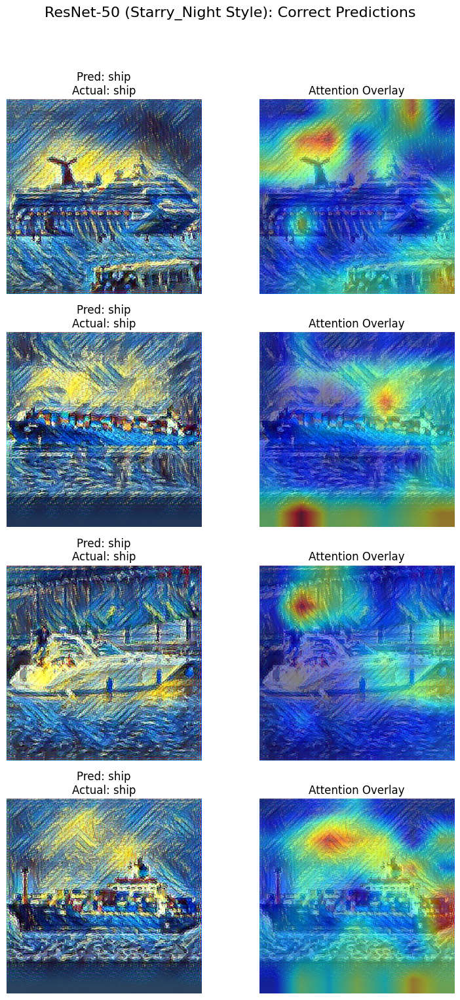

Generating attention maps for ResNet-50 (Starry_Night Style) incorrect predictions...


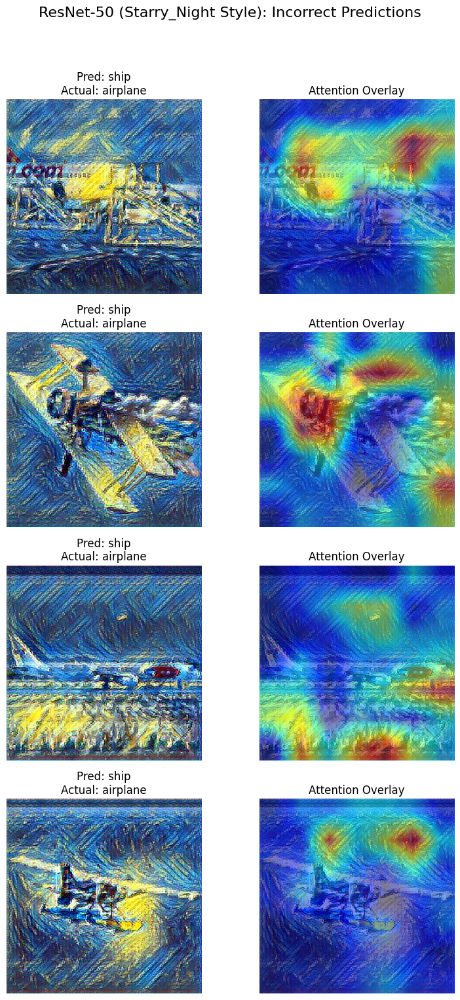

Generating attention maps for Vision Transformer (Starry_Night Style) correct predictions...


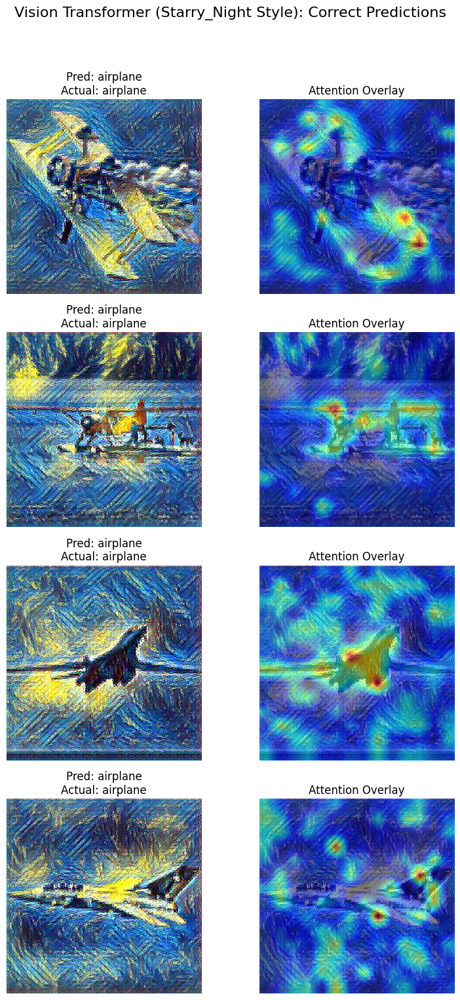

Generating attention maps for Vision Transformer (Starry_Night Style) incorrect predictions...


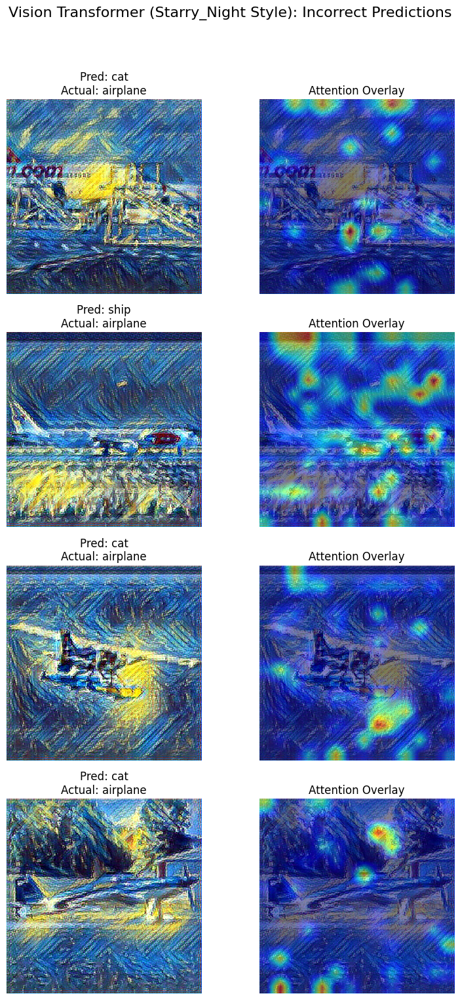

In [7]:
print("\n" + "=" * 80)
print("EVALUATION")
print("=" * 80)

all_results = {}
resnet_total_shape_match = 0
resnet_total_images = 0
vit_total_shape_match = 0
vit_total_images = 0

print("Starting evaluations...")

for style in styles:
    print(f"\n--- Evaluating Style: {style.upper()} ---")

    # Evaluate ResNet
    print(f"  Evaluating ResNet-50...")
    resnet_results = evaluate_model_on_style(
        model=resnet,
        style=style,
        full_dataset=full_cue_conflict_dataset,
        device=device,
        batch_size=BATCH_SIZE,
        num_samples_to_show=num_samples_to_show,
    )

    if resnet_results is None:
        print(f"  No samples found for style {style.upper()}. Skipping.")
        continue

    # Evaluate ViT
    print(f"  Evaluating ViT...")
    vit_results = evaluate_model_on_style(
        model=vit,
        style=style,
        full_dataset=full_cue_conflict_dataset,
        device=device,
        batch_size=BATCH_SIZE,
        num_samples_to_show=num_samples_to_show,
    )

    # Store results
    all_results[style] = {"resnet": resnet_results, "vit": vit_results}

    # Add to totals
    resnet_total_shape_match += resnet_results["shape_match_count"]
    resnet_total_images += resnet_results["total_images"]
    vit_total_shape_match += vit_results["shape_match_count"]
    vit_total_images += vit_results["total_images"]

    # Print style results
    print(
        f"  Results: ResNet {resnet_results['accuracy']:.2f}% | ViT {vit_results['accuracy']:.2f}%"
    )

print("\n" + "=" * 80)
print("FINAL SHAPE BIAS SUMMARY (ACROSS ALL STYLES)")
print("=" * 80)

final_resnet_shape_bias = (
    (resnet_total_shape_match / resnet_total_images) * 100
    if resnet_total_images > 0
    else 0
)
final_vit_shape_bias = (
    (vit_total_shape_match / vit_total_images) * 100 if vit_total_images > 0 else 0
)

print(
    f"ResNet-50 Total Shape Bias: {final_resnet_shape_bias:.2f}% ({resnet_total_shape_match}/{resnet_total_images} correct)"
)
print(
    f"Vision Transformer (ViT) Total Shape Bias: {final_vit_shape_bias:.2f}% ({vit_total_shape_match}/{vit_total_images} correct)"
)

# Detailed breakdown by style
print(f"\nDetailed Breakdown by Style:")
print("-" * 60)
for style in styles:
    if style in all_results:
        resnet_acc = all_results[style]["resnet"]["accuracy"]
        vit_acc = all_results[style]["vit"]["accuracy"]

        resnet_count = all_results[style]["resnet"]["shape_match_count"]
        resnet_total = all_results[style]["resnet"]["total_images"]
        vit_count = all_results[style]["vit"]["shape_match_count"]
        vit_total = all_results[style]["vit"]["total_images"]

        print(
            f"{style.upper():>15}: ResNet {resnet_acc:>6.2f}% ({resnet_count:>3}/{resnet_total:>3}) | "
            f"ViT {vit_acc:>6.2f}% ({vit_count:>3}/{vit_total:>3})"
        )

print("=" * 80)

def get_resnet_attention_map_safe(model, image_tensor, device):
    """SAFE attention map that uses a completely separate model copy."""
    attention_model = copy.deepcopy(model)
    attention_model.eval()
    attention_model.to(device)

    with torch.enable_grad():
        input_tensor = image_tensor.clone().to(device).unsqueeze(0)
        input_tensor.requires_grad = True

        features, gradients = None, None

        def forward_hook(m, i, o):
            nonlocal features
            features = o

        def backward_hook(m, i, o):
            nonlocal gradients
            gradients = o[0]

        target_layer = attention_model.layer4[-1]
        f_hook = target_layer.register_forward_hook(forward_hook)
        b_hook = target_layer.register_full_backward_hook(backward_hook)

        output = attention_model(input_tensor)
        pred_class_idx = output.argmax(dim=1)
        attention_model.zero_grad()
        output[:, pred_class_idx].backward()

        f_hook.remove()
        b_hook.remove()

        if gradients is None:
            return to_pil_image(torch.zeros(image_tensor.shape[1:]))

        pooled_gradients = torch.mean(gradients, dim=[0, 2, 3])
        features = features.squeeze(0)
        for i in range(features.shape[0]):
            features[i, :, :] *= pooled_gradients[i]

        heatmap = torch.mean(features, dim=0).squeeze()
        heatmap = F.relu(heatmap)
        heatmap /= torch.max(heatmap) if torch.max(heatmap) > 0 else 1.0

    del attention_model
    if "cuda" in str(device):
        torch.cuda.empty_cache()

    return to_pil_image(heatmap.cpu())


def get_vit_attention_map_safe(model, image_tensor, device, image_size=(224, 224)):
    """SAFE attention map that uses a completely separate model copy."""
    attention_model = copy.deepcopy(model)
    attention_model.eval()
    attention_model.to(device)

    with torch.enable_grad():
        input_tensor = image_tensor.clone().to(device).unsqueeze(0)
        input_tensor.requires_grad = True

        features, grads = None, None

        def forward_hook(m, i, o):
            nonlocal features
            features = o

        def backward_hook(m, i, o):
            nonlocal grads
            grads = o[0]

        target_layer = attention_model.blocks[-1]
        f_hook = target_layer.register_forward_hook(forward_hook)
        b_hook = target_layer.register_full_backward_hook(backward_hook)

        output = attention_model(input_tensor)
        pred_class_idx = output.argmax(dim=1)
        attention_model.zero_grad()
        output[:, pred_class_idx].backward()

        f_hook.remove()
        b_hook.remove()

        if grads is None:
            return to_pil_image(torch.zeros(image_size))

        weights = grads.mean(dim=1).squeeze(0)
        patch_features = features[0, 1:, :]

        cam = torch.einsum("pc,c->p", patch_features, weights)
        cam = F.relu(cam)

        num_patches_side = int(cam.shape[-1] ** 0.5)
        cam_2d = cam.reshape(1, 1, num_patches_side, num_patches_side)

        heatmap = F.interpolate(
            cam_2d, size=image_size, mode="bilinear", align_corners=False
        ).squeeze()
        heatmap -= heatmap.min()
        heatmap /= heatmap.max() if heatmap.max() > 0 else 1.0

    del attention_model
    if "cuda" in str(device):
        torch.cuda.empty_cache()

    return to_pil_image(heatmap.cpu())


def overlay_heatmap(image_vis, heatmap_pil, alpha=0.5, cmap="jet"):
    """Overlays a heatmap on a de-normalized image tensor."""
    image_vis_clamped = torch.clamp(image_vis, 0, 1)
    image_pil = to_pil_image(image_vis_clamped.cpu())

    heatmap_resized = heatmap_pil.resize(image_pil.size, Image.BILINEAR)
    colormap = plt.get_cmap(cmap)
    heatmap_array = np.array(heatmap_resized)

    if heatmap_array.max() > 1:
        heatmap_array = heatmap_array / 255.0

    heatmap_colored_np = (colormap(heatmap_array) * 255).astype(np.uint8)
    heatmap_colored = Image.fromarray(heatmap_colored_np)

    overlaid_image = Image.blend(
        image_pil.convert("RGB"), heatmap_colored.convert("RGB"), alpha
    )
    return overlaid_image


print("\n" + "=" * 80)
print("PHASE 2: GENERATING VISUALIZATIONS WITH ATTENTION MAPS")
print("=" * 80)

for style in styles:
    if style not in all_results:
        continue

    print(f"\n--- Visualizing Style: {style.upper()} ---")

    # ResNet Visualizations
    model_name_resnet = f"ResNet-50 ({style.title()} Style)"
    correct_samples_resnet = all_results[style]["resnet"]["correct_samples"]
    incorrect_samples_resnet = all_results[style]["resnet"]["incorrect_samples"]

    if len(correct_samples_resnet) > 0:
        print(
            f"Generating attention maps for {model_name_resnet} correct predictions..."
        )
        fig, axes = plt.subplots(
            len(correct_samples_resnet), 2, figsize=(8, 4 * len(correct_samples_resnet))
        )
        if len(correct_samples_resnet) == 1:
            axes = [axes]
        fig.suptitle(f"{model_name_resnet}: Correct Predictions", fontsize=16)

        for i, (image_normalized, pred, true) in enumerate(correct_samples_resnet):
            ax1, ax2 = axes[i]

            image_vis = display_image_properly(image_normalized)
            ax1.imshow(image_vis.permute(1, 2, 0))
            ax1.set_title(f"Pred: {class_names[pred]}\nActual: {class_names[true]}")
            ax1.axis("off")

            resnet_map = get_resnet_attention_map_safe(resnet, image_normalized, device)
            ax2.imshow(overlay_heatmap(image_vis, resnet_map))
            ax2.set_title("Attention Overlay")
            ax2.axis("off")

        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()
    else:
        print(f"No correct predictions to show for {model_name_resnet}.")

    if len(incorrect_samples_resnet) > 0:
        print(
            f"Generating attention maps for {model_name_resnet} incorrect predictions..."
        )
        fig, axes = plt.subplots(
            len(incorrect_samples_resnet),
            2,
            figsize=(8, 4 * len(incorrect_samples_resnet)),
        )
        if len(incorrect_samples_resnet) == 1:
            axes = [axes]
        fig.suptitle(f"{model_name_resnet}: Incorrect Predictions", fontsize=16)

        for i, (image_normalized, pred, true) in enumerate(incorrect_samples_resnet):
            ax1, ax2 = axes[i]

            image_vis = display_image_properly(image_normalized)
            ax1.imshow(image_vis.permute(1, 2, 0))
            ax1.set_title(f"Pred: {class_names[pred]}\nActual: {class_names[true]}")
            ax1.axis("off")

            resnet_map = get_resnet_attention_map_safe(resnet, image_normalized, device)
            ax2.imshow(overlay_heatmap(image_vis, resnet_map))
            ax2.set_title("Attention Overlay")
            ax2.axis("off")

        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()
    else:
        print(f"No incorrect predictions to show for {model_name_resnet}.")

    # ViT Visualizations
    model_name_vit = f"Vision Transformer ({style.title()} Style)"
    correct_samples_vit = all_results[style]["vit"]["correct_samples"]
    incorrect_samples_vit = all_results[style]["vit"]["incorrect_samples"]

    if len(correct_samples_vit) > 0:
        print(f"Generating attention maps for {model_name_vit} correct predictions...")
        fig, axes = plt.subplots(
            len(correct_samples_vit), 2, figsize=(8, 4 * len(correct_samples_vit))
        )
        if len(correct_samples_vit) == 1:
            axes = [axes]
        fig.suptitle(f"{model_name_vit}: Correct Predictions", fontsize=16)

        for i, (image_normalized, pred, true) in enumerate(correct_samples_vit):
            ax1, ax2 = axes[i]

            image_vis = display_image_properly(image_normalized)
            ax1.imshow(image_vis.permute(1, 2, 0))
            ax1.set_title(f"Pred: {class_names[pred]}\nActual: {class_names[true]}")
            ax1.axis("off")

            vit_map = get_vit_attention_map_safe(vit, image_normalized, device)
            ax2.imshow(overlay_heatmap(image_vis, vit_map))
            ax2.set_title("Attention Overlay")
            ax2.axis("off")

        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()
    else:
        print(f"No correct predictions to show for {model_name_vit}.")

    if len(incorrect_samples_vit) > 0:
        print(
            f"Generating attention maps for {model_name_vit} incorrect predictions..."
        )
        fig, axes = plt.subplots(
            len(incorrect_samples_vit), 2, figsize=(8, 4 * len(incorrect_samples_vit))
        )
        if len(incorrect_samples_vit) == 1:
            axes = [axes]
        fig.suptitle(f"{model_name_vit}: Incorrect Predictions", fontsize=16)

        for i, (image_normalized, pred, true) in enumerate(incorrect_samples_vit):
            ax1, ax2 = axes[i]

            image_vis = display_image_properly(image_normalized)
            ax1.imshow(image_vis.permute(1, 2, 0))
            ax1.set_title(f"Pred: {class_names[pred]}\nActual: {class_names[true]}")
            ax1.axis("off")

            vit_map = get_vit_attention_map_safe(vit, image_normalized, device)
            ax2.imshow(overlay_heatmap(image_vis, vit_map))
            ax2.set_title("Attention Overlay")
            ax2.axis("off")

        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()
    else:
        print(f"No incorrect predictions to show for {model_name_vit}.")

### Translation

In [26]:
print(transform)

ImageClassification(
    crop_size=[224]
    resize_size=[232]
    mean=[0.485, 0.456, 0.406]
    std=[0.229, 0.224, 0.225]
    interpolation=InterpolationMode.BILINEAR
)


In [73]:
translation_transform = transforms.Compose(
    [
        transforms.RandomAffine(degrees=0, translate=(0.4, 0.4)),
        transform,
    ]
)

translated_test_dataset = datasets.STL10(
    root="./data", split="test", download=True, transform=translation_transform
)
translated_test_loader = DataLoader(
    translated_test_dataset, batch_size=BATCH_SIZE, shuffle=False
)

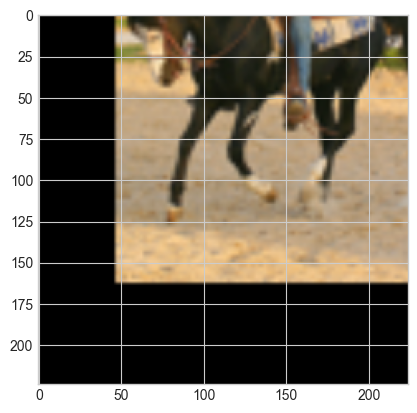

In [74]:
data, target = next(iter(translated_test_loader))
img = data[0].permute(1, 2, 0).cpu().numpy()
plt.imshow((img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])).clip(0, 1))

In [ ]:
resnet.eval()
original_preds_resnet = []
with torch.no_grad():
    for data, _ in tqdm(test_loader, desc="Getting Original Preds (ResNet)"):
        data = data.to(device)
        output = resnet(data)
        _, predicted = torch.max(output.data, 1)
        original_preds_resnet.extend(predicted.cpu().numpy())
original_preds_resnet = np.array(original_preds_resnet)

translated_preds_resnet = []
translated_correct_resnet = 0
translated_total_resnet = 0
with torch.no_grad():
    for data, target in tqdm(translated_test_loader, desc="Getting Translated Preds (ResNet)"):
        data, target = data.to(device), target.to(device)
        output = resnet(data)
        _, predicted = torch.max(output.data, 1)
        translated_preds_resnet.extend(predicted.cpu().numpy())
        translated_total_resnet += target.size(0)
        translated_correct_resnet += (predicted == target).sum().item()
translated_preds_resnet = np.array(translated_preds_resnet)

Getting Translated Preds (ResNet): 100%|██████████| 63/63 [00:39<00:00,  1.59it/s]


In [76]:
vit.eval()
original_preds_vit = []
with torch.no_grad():
    for data, _ in tqdm(test_loader, desc="Getting Original Preds (ViT)"):
        data = data.to(device)
        output = vit(data)
        _, predicted = torch.max(output.data, 1)
        original_preds_vit.extend(predicted.cpu().numpy())
original_preds_vit = np.array(original_preds_vit)

translated_preds_vit = []
translated_correct_vit = 0
translated_total_vit = 0
with torch.no_grad():
    for data, target in tqdm(translated_test_loader, desc="Getting Translated Preds (ViT)"):
        data, target = data.to(device), target.to(device)
        output = vit(data)
        _, predicted = torch.max(output.data, 1)
        translated_preds_vit.extend(predicted.cpu().numpy())
        translated_total_vit += target.size(0)
        translated_correct_vit += (predicted == target).sum().item()
translated_preds_vit = np.array(translated_preds_vit)

Getting Translated Preds (ViT): 100%|██████████| 63/63 [00:27<00:00,  2.30it/s]


In [77]:
resnet_translated_acc = 100 * translated_correct_resnet / translated_total_resnet
vit_translated_acc = 100 * translated_correct_vit / translated_total_vit

resnet_consistency = np.sum(original_preds_resnet == translated_preds_resnet) / len(original_preds_resnet) * 100
vit_consistency = np.sum(original_preds_vit == translated_preds_vit) / len(original_preds_vit) * 100

resnet_original_acc = 100 * np.sum(original_preds_resnet == np.array(test_dataset.labels)) / len(test_dataset)
vit_original_acc = 100 * np.sum(original_preds_vit == np.array(test_dataset.labels)) / len(test_dataset)

resnet_translated_acc = 100 * translated_correct_resnet / translated_total_resnet
vit_translated_acc = 100 * translated_correct_vit / translated_total_vit

print("\n--- Translation Invariance Test Results ---")
print("\n-- ResNet-50 --")
print(f"Original Accuracy: {resnet_original_acc:.2f}%")
print(f"Translated Accuracy: {resnet_translated_acc:.2f}%")
print(f"Accuracy Drop: {resnet_original_acc - resnet_translated_acc:.2f}%")
print(f"Prediction Consistency: {resnet_consistency:.2f}%")

print("\n-- Vision Transformer (ViT) --")
print(f"Original Accuracy: {vit_original_acc:.2f}%")
print(f"Translated Accuracy: {vit_translated_acc:.2f}%")
print(f"Accuracy Drop: {vit_original_acc - vit_translated_acc:.2f}%")
print(f"Prediction Consistency: {vit_consistency:.2f}%")


--- Translation Invariance Test Results ---

-- ResNet-50 --
Original Accuracy: 96.10%
Translated Accuracy: 92.44%
Accuracy Drop: 3.66%
Prediction Consistency: 93.15%

-- Vision Transformer (ViT) --
Original Accuracy: 97.51%
Translated Accuracy: 93.69%
Accuracy Drop: 3.83%
Prediction Consistency: 93.99%


### Permutation/Occlusion

In [100]:
patch_size = 16

class PatchPermutation:
    def __init__(self, patch_size):
        self.patch_size = patch_size

    def __call__(self, img):
        img_tensor = transforms.ToTensor()(img)
        C, H, W = img_tensor.shape
        num_patches_h = H // self.patch_size
        num_patches_w = W // self.patch_size
        
        patches = img_tensor.view(C, num_patches_h, self.patch_size, num_patches_w, self.patch_size)
        patches = patches.permute(1, 3, 0, 2, 4).contiguous()
        patches = patches.view(-1, C, self.patch_size, self.patch_size)

        perm = torch.randperm(patches.size(0))
        shuffled_patches = patches[perm]

        shuffled_patches = shuffled_patches.view(num_patches_h, num_patches_w, C, self.patch_size, self.patch_size)
        shuffled_tensor = shuffled_patches.permute(2, 0, 3, 1, 4).contiguous()
        shuffled_tensor = shuffled_tensor.view(C, H, W)
        
        return transforms.ToPILImage()(shuffled_tensor)

class PatchOcclusion:
    def __init__(self, patch_size, occlusion_ratio=0.5):
        self.patch_size = patch_size
        self.occlusion_ratio = occlusion_ratio

    def __call__(self, img):
        img_tensor = transforms.ToTensor()(img)
        C, H, W = img_tensor.shape
        num_patches_h = H // self.patch_size
        num_patches_w = W // self.patch_size
        num_patches = num_patches_h * num_patches_w
        num_occlude = int(num_patches * self.occlusion_ratio)

        occlude_indices = random.sample(range(num_patches), num_occlude)

        for idx in occlude_indices:
            h_start = (idx // num_patches_w) * self.patch_size
            w_start = (idx % num_patches_w) * self.patch_size
            img_tensor[:, h_start:h_start+self.patch_size, w_start:w_start+self.patch_size] = 0
            
        return transforms.ToPILImage()(img_tensor)


permutation_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    PatchPermutation(patch_size=patch_size),
    transform,
])
permuted_test_dataset = datasets.STL10(root="./data", split="test", download=True, transform=permutation_transform)
permuted_test_loader = DataLoader(permuted_test_dataset, batch_size=BATCH_SIZE, shuffle=False)

occlusion_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    PatchOcclusion(patch_size=patch_size, occlusion_ratio=0.3),
    transform,
])
occluded_test_dataset = datasets.STL10(root="./data", split="test", download=True, transform=occlusion_transform)
occluded_test_loader = DataLoader(occluded_test_dataset, batch_size=BATCH_SIZE, shuffle=False)

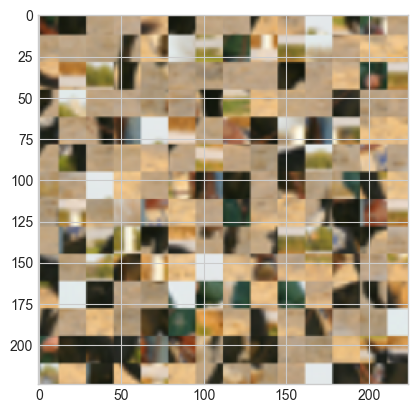

In [81]:
data, target = next(iter(permuted_test_loader))
img = data[0].permute(1, 2, 0).cpu().numpy()
plt.imshow((img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])).clip(0, 1))
plt.show()

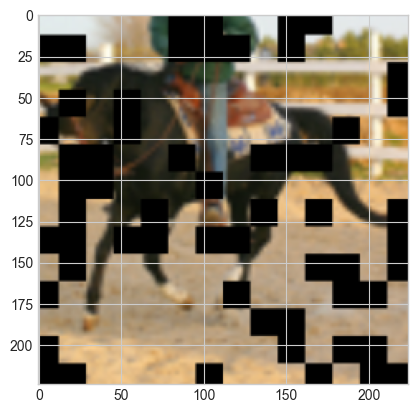

In [101]:
data, target = next(iter(occluded_test_loader))
img = data[0].permute(1, 2, 0).cpu().numpy()
plt.imshow((img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])).clip(0, 1))
plt.show()

In [82]:
resnet.eval()
correct_test_resnet = 0
total_test_resnet = 0
with torch.no_grad():
    pbar_resnet = tqdm(permuted_test_loader, desc="Evaluating ResNet-50 on Permuted Test Set")
    for data, target in pbar_resnet:
        data, target = data.to(device), target.to(device)
        output = resnet(data)
        _, predicted = torch.max(output.data, 1)
        total_test_resnet += target.size(0)
        correct_test_resnet += (predicted == target).sum().item()
        pbar_resnet.set_postfix({'accuracy': f"{100 * correct_test_resnet / total_test_resnet:.2f}%"})
resnet_permuted_acc = 100 * correct_test_resnet / total_test_resnet
print(f"Accuracy of ResNet-50 on Permuted Test Set: {resnet_permuted_acc:.2f}%")


Evaluating ResNet-50 on Permuted Test Set: 100%|██████████| 63/63 [00:50<00:00,  1.25it/s, accuracy=21.18%]

Accuracy of ResNet-50 on Permuted Test Set: 21.18%


In [84]:
vit.eval()
correct_test_vit = 0
total_test_vit = 0
with torch.no_grad():
    pbar_vit = tqdm(permuted_test_loader, desc="Evaluating ViT on Permuted Test Set")
    for data, target in pbar_vit:
        data, target = data.to(device), target.to(device)
        output = vit(data)
        _, predicted = torch.max(output.data, 1)
        total_test_vit += target.size(0)
        correct_test_vit += (predicted == target).sum().item()
        pbar_vit.set_postfix({'accuracy': f"{100 * correct_test_vit / total_test_vit:.2f}%"})
vit_permuted_acc = 100 * correct_test_vit / total_test_vit
print(f"Accuracy of ViT on Permuted Test Set: {vit_permuted_acc:.2f}%")

Evaluating ViT on Permuted Test Set: 100%|██████████| 63/63 [00:39<00:00,  1.58it/s, accuracy=20.19%]

Accuracy of ViT on Permuted Test Set: 20.19%


In [102]:
resnet.eval()
correct_test_resnet = 0
total_test_resnet = 0
with torch.no_grad():
    pbar_resnet = tqdm(occluded_test_loader, desc="Evaluating ResNet-50 on Occluded Test Set")
    for data, target in pbar_resnet:
        data, target = data.to(device), target.to(device)
        output = resnet(data)
        _, predicted = torch.max(output.data, 1)
        total_test_resnet += target.size(0)
        correct_test_resnet += (predicted == target).sum().item()
        pbar_resnet.set_postfix({'accuracy': f"{100 * correct_test_resnet / total_test_resnet:.2f}%"})
resnet_occluded_acc = 100 * correct_test_resnet / total_test_resnet
print(f"Accuracy of ResNet-50 on Occluded Test Set: {resnet_occluded_acc:.2f}%")

Evaluating ResNet-50 on Occluded Test Set: 100%|██████████| 63/63 [01:09<00:00,  1.10s/it, accuracy=75.39%]

Accuracy of ResNet-50 on Occluded Test Set: 75.39%


In [103]:
vit.eval()
correct_test_vit = 0
total_test_vit = 0
with torch.no_grad():
    pbar_vit = tqdm(occluded_test_loader, desc="Evaluating ViT on Occluded Test Set")
    for data, target in pbar_vit:
        data, target = data.to(device), target.to(device)
        output = vit(data)
        _, predicted = torch.max(output.data, 1)
        total_test_vit += target.size(0)
        correct_test_vit += (predicted == target).sum().item()
        pbar_vit.set_postfix({'accuracy': f"{100 * correct_test_vit / total_test_vit:.2f}%"})
vit_occluded_acc = 100 * correct_test_vit / total_test_vit
print(f"Accuracy of ViT on Occluded Test Set: {vit_occluded_acc:.2f}%")

Evaluating ViT on Occluded Test Set:   0%|          | 0/63 [00:00<?, ?it/s]

Evaluating ViT on Occluded Test Set: 100%|██████████| 63/63 [00:45<00:00,  1.37it/s, accuracy=83.30%]

Accuracy of ViT on Occluded Test Set: 83.30%


### Feature Visualisation


--- Processing Style: ABSTRACT ---


Extracting ResNet-50 features from abstract style: 100%|██████████| 1/1 [00:04<00:00,  4.11s/it]
Extracting ViT features from abstract style: 100%|██████████| 1/1 [00:33<00:00, 33.99s/it]


Running t-SNE for ResNet-50: abstract...


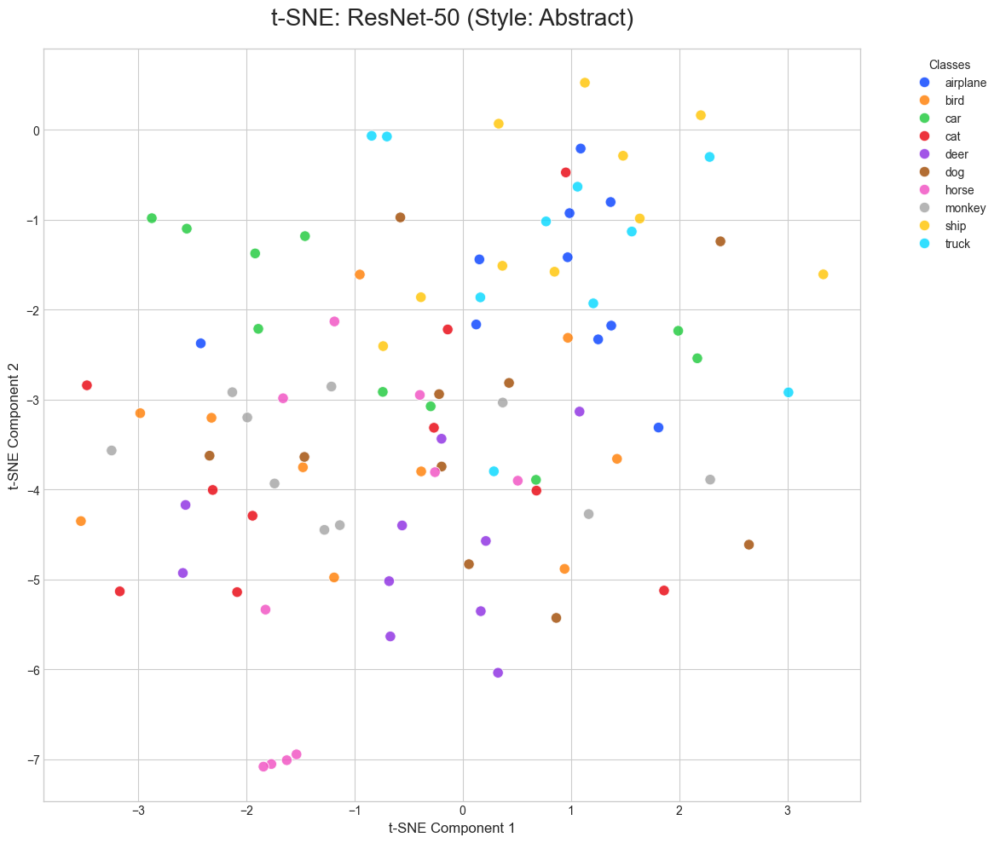

Running t-SNE for ViT: abstract...


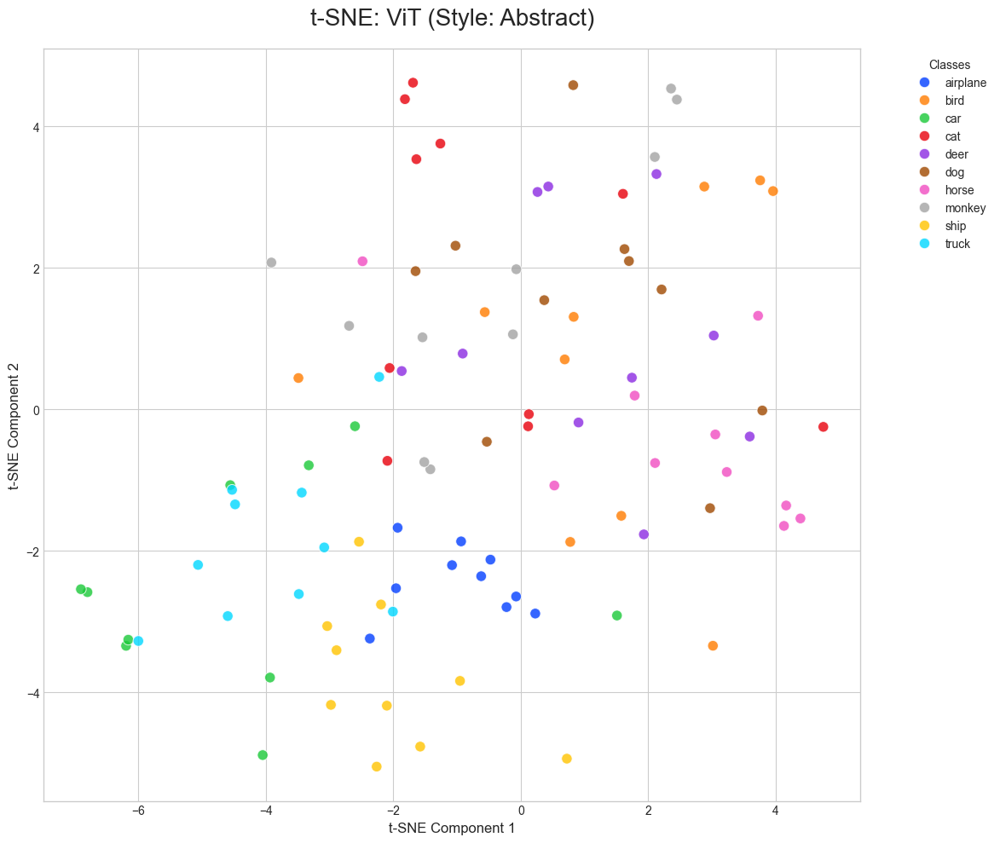


--- Processing Style: MOSAIC ---


Extracting ViT features from mosaic style: 100%|██████████| 1/1 [00:30<00:00, 30.16s/it]


Running t-SNE for ResNet-50: mosaic...


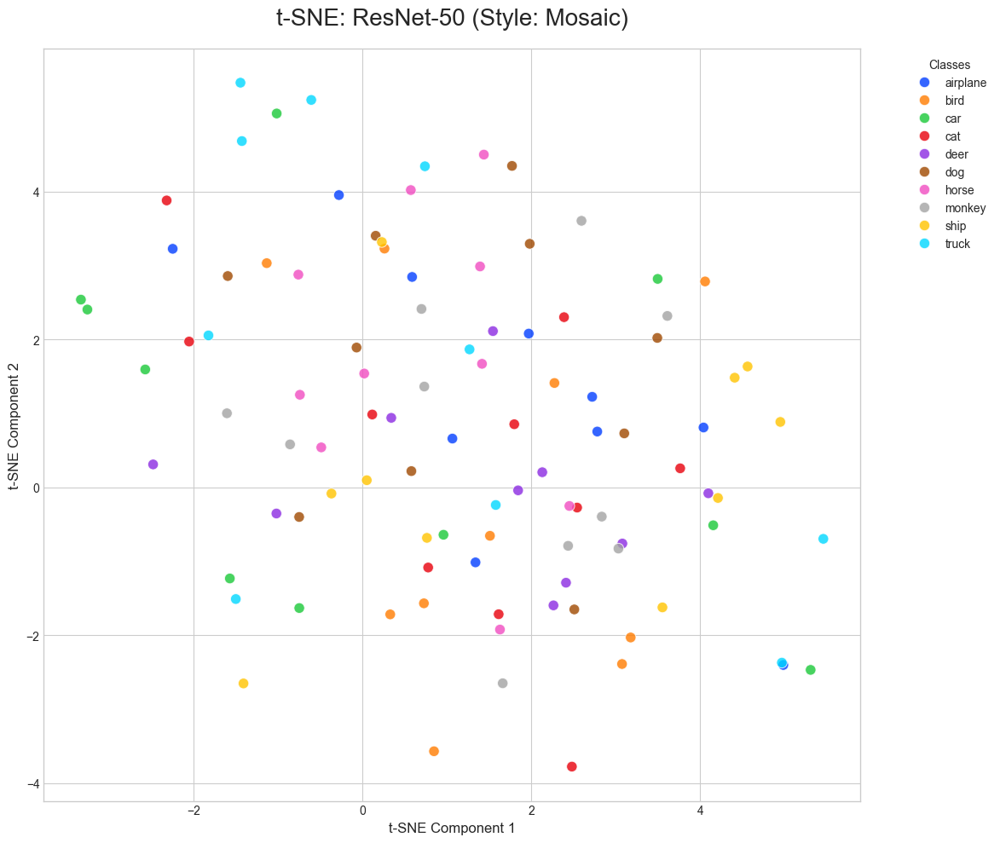

Running t-SNE for ViT: mosaic...


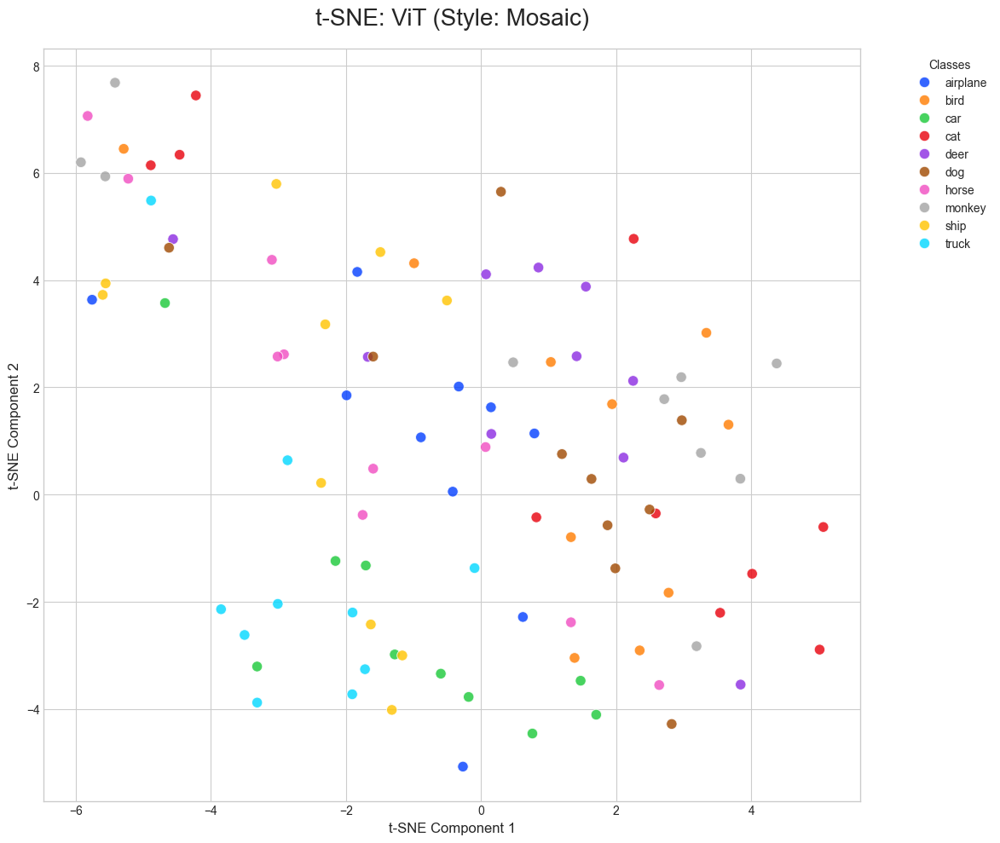


--- Processing Style: RAIN_PRINCESS ---


Extracting ResNet-50 features from rain_princess style: 100%|██████████| 1/1 [00:00<00:00,  1.50it/s]
Extracting ViT features from rain_princess style: 100%|██████████| 1/1 [00:03<00:00,  3.38s/it]


Running t-SNE for ResNet-50: rain_princess...


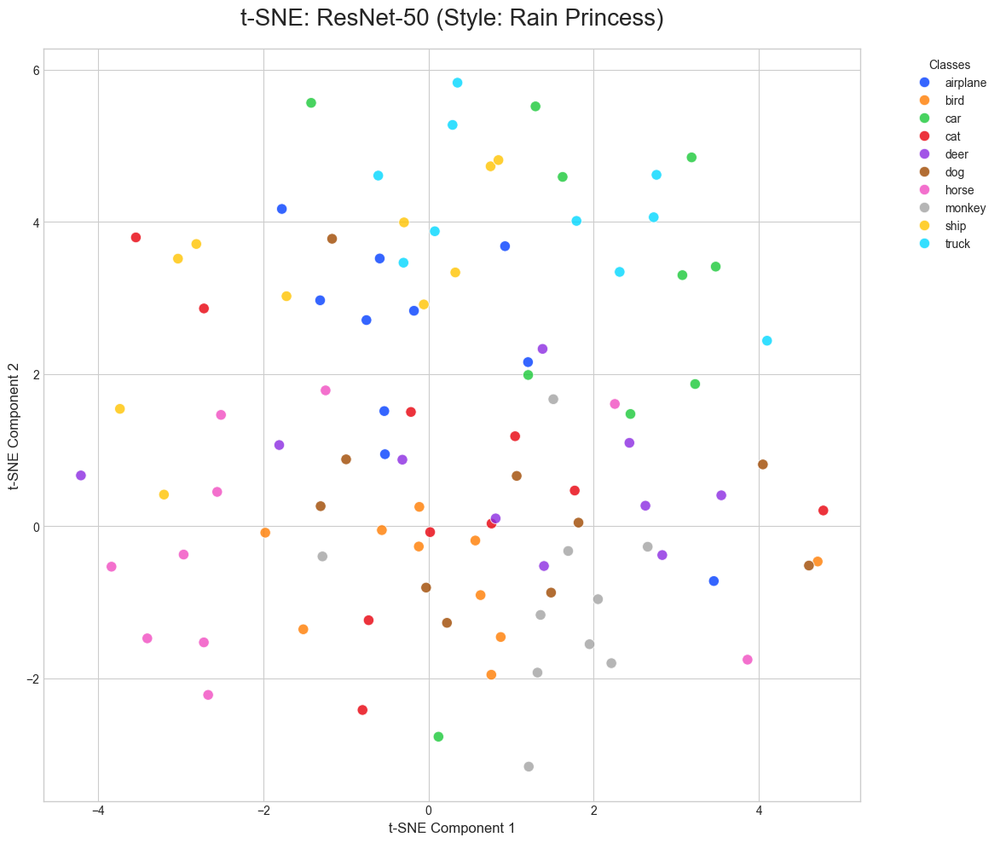

Running t-SNE for ViT: rain_princess...


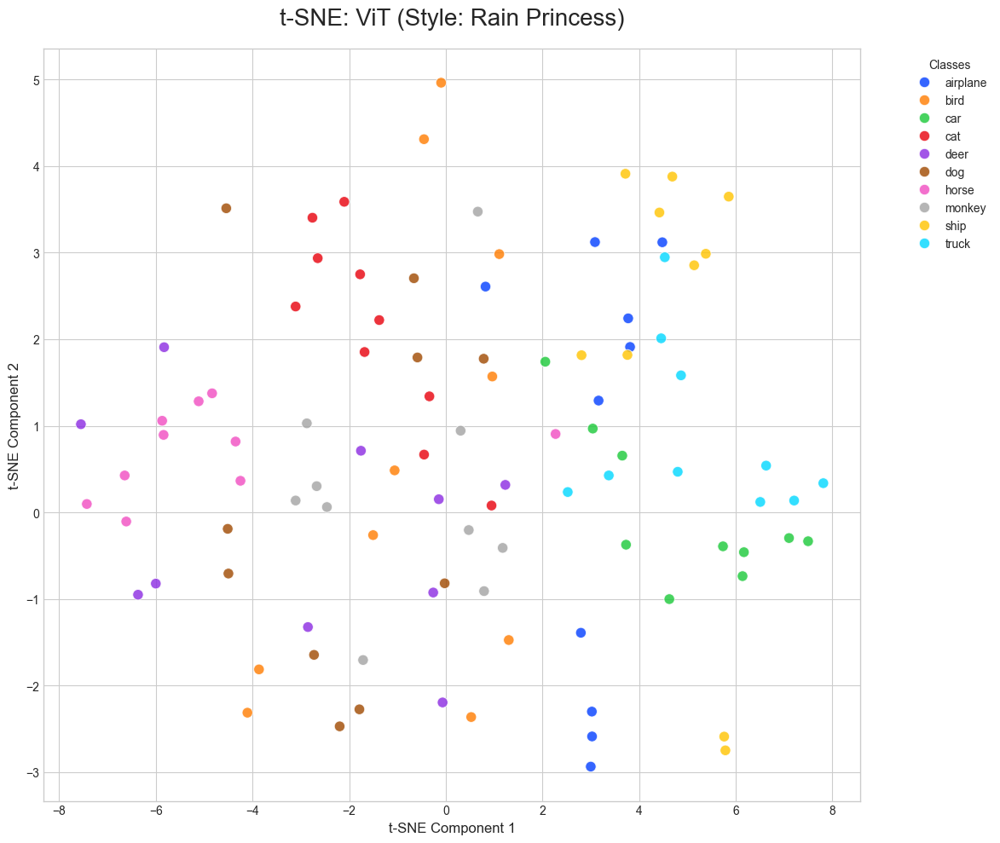


--- Processing Style: STARRY_NIGHT ---


Extracting ResNet-50 features from starry_night style: 100%|██████████| 1/1 [00:03<00:00,  3.24s/it]
Extracting ViT features from starry_night style: 100%|██████████| 1/1 [00:50<00:00, 50.14s/it]


Running t-SNE for ResNet-50: starry_night...


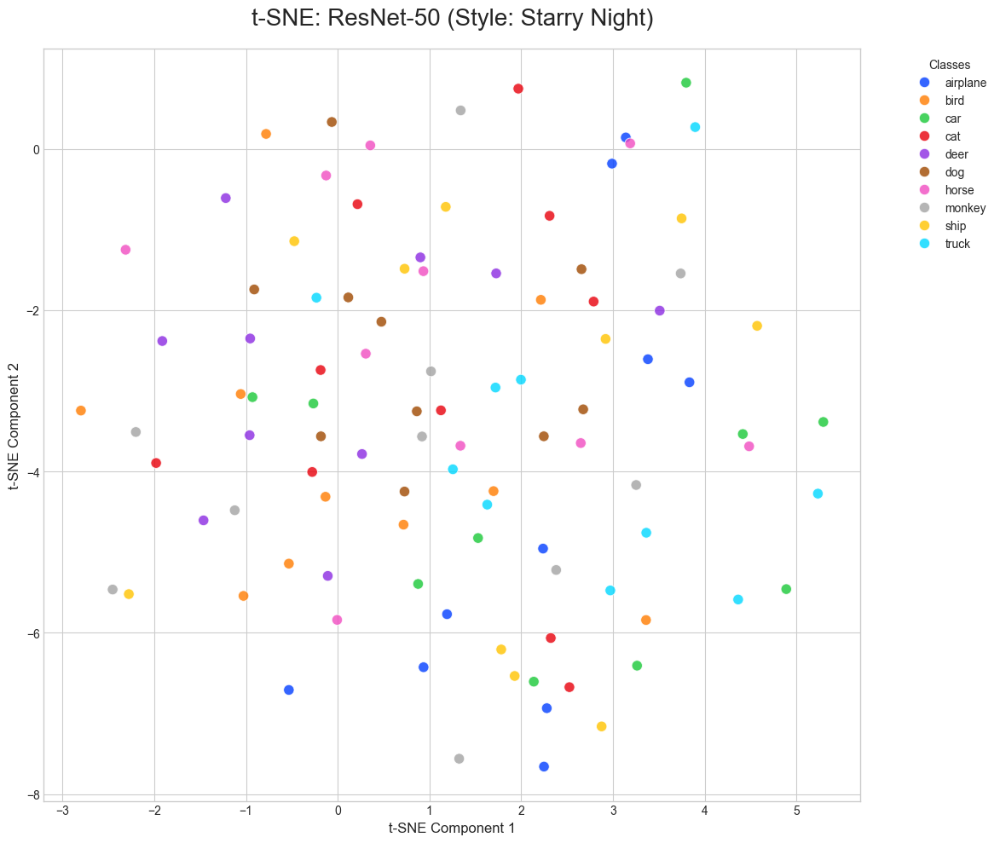

Running t-SNE for ViT: starry_night...


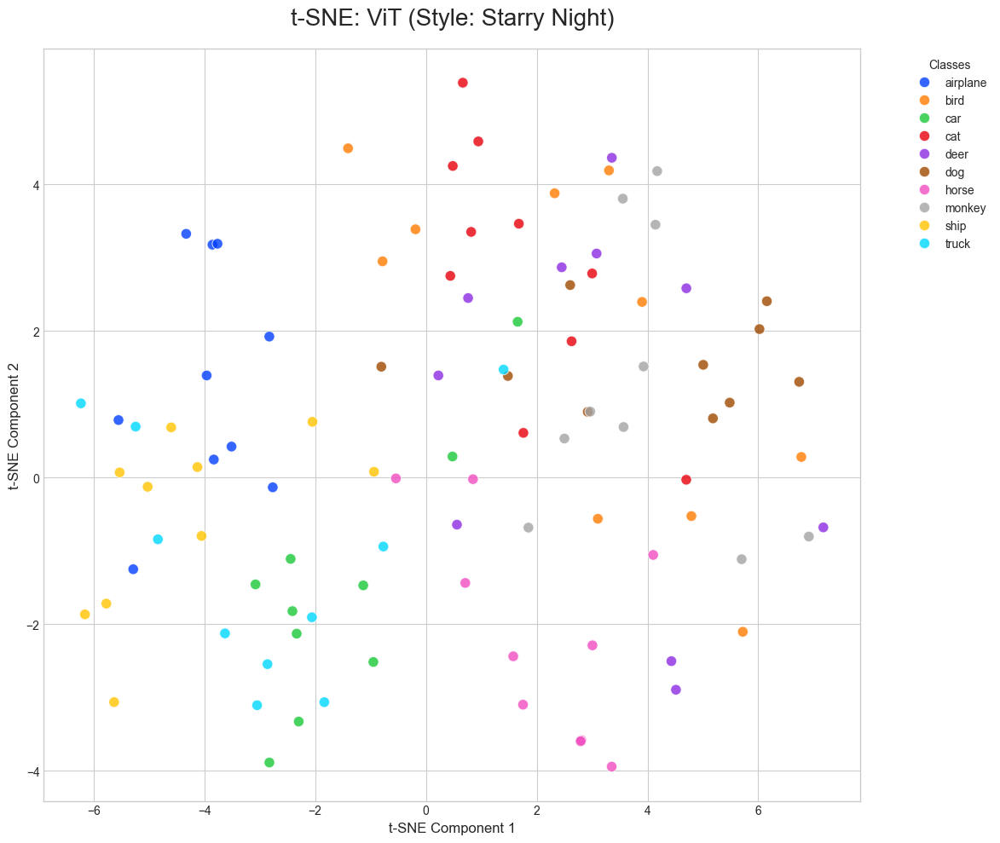

In [ ]:
from sklearn.manifold import TSNE
import seaborn as sns
from torch.utils.data import Subset
cue_conflict_dir = "data/cue_conflict_dataset"
cue_conflict_dataset = datasets.ImageFolder(
    root=cue_conflict_dir,
    transform=transform
)


def extract_features(model, data_loader, device, model_name, dataset_name):
    features, labels = [], []
    def hook(module, input, output):
        features.append(input[0].detach().cpu().numpy())

    if isinstance(model, models.ResNet):
        handle = model.fc.register_forward_hook(hook)
    elif isinstance(model, timm.models.VisionTransformer):
        handle = model.head.register_forward_hook(hook)
    else:
        raise TypeError("Model type not supported.")

    with torch.no_grad():
        for imgs, lbls in tqdm(data_loader, desc=f"Extracting {model_name} features from {dataset_name}"):
            imgs = imgs.to(device)
            _ = model(imgs)
            labels.append(lbls.cpu().numpy())
    handle.remove()
    return np.concatenate(features), np.concatenate(labels)



def plot_tsne_single_style(features, labels, style_name, model_name, class_names):
    print(f"Running t-SNE for {model_name}: {style_name}...")
    tsne = TSNE(n_components=2, perplexity=30, max_iter=1000, random_state=42)
    tsne_results = tsne.fit_transform(features)

    plt.style.use("seaborn-v0_8-whitegrid")
    plt.figure(figsize=(14, 10))
    palette = sns.color_palette("bright", n_colors=len(class_names))

    sns.scatterplot(
        x=tsne_results[:, 0], y=tsne_results[:, 1], hue=labels,
        palette=palette, s=80, alpha=0.8, legend='full'
    )
    plt.title(f't-SNE: {model_name} (Style: {style_name.replace("_", " ").title()})', fontsize=20, pad=20)
    plt.xlabel('t-SNE Component 1', fontsize=12)
    plt.ylabel('t-SNE Component 2', fontsize=12)
    
    handles, labels = plt.gca().get_legend_handles_labels()
    class_labels = [class_names[int(l)] for l in labels if l.isdigit()]
    
    plt.legend(handles=handles, labels=class_labels, title='Classes', 
               bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout(rect=[0, 0, 0.85, 1])
    plt.show()

styles = ['abstract', 'mosaic', 'rain_princess', 'starry_night']
class_names = cue_conflict_dataset.classes

for style in styles:
    print(f"\n--- Processing Style: {style.upper()} ---")

    style_dataset = copy.deepcopy(cue_conflict_dataset)
    
    style_samples = [s for s in cue_conflict_dataset.samples if f"style_{style}" in s[0]]
    
    style_dataset.samples = style_samples
    style_dataset.imgs = style_samples 
    
    style_loader = DataLoader(style_dataset, batch_size=256, shuffle=False)
    
    resnet_style_feat, resnet_style_lbl = extract_features(resnet, style_loader, device, "ResNet-50", f"{style} style")
    vit_style_feat, vit_style_lbl = extract_features(vit, style_loader, device, "ViT", f"{style} style")

    plot_tsne_single_style(resnet_style_feat, resnet_style_lbl, style, 'ResNet-50', class_names)
    plot_tsne_single_style(vit_style_feat, vit_style_lbl, style, 'ViT', class_names)

--- Extracting Features for ResNet-50 ---


Extracting ResNet-50 features from Grayscale: 100%|██████████| 5/5 [00:09<00:00,  1.90s/it]



--- Extracting Features for ViT ---


Extracting ViT features from Grayscale: 100%|██████████| 5/5 [01:05<00:00, 13.05s/it]



--- Generating Original vs. Grayscale Plots ---
Running t-SNE for ResNet-50: Original vs. Grayscale...


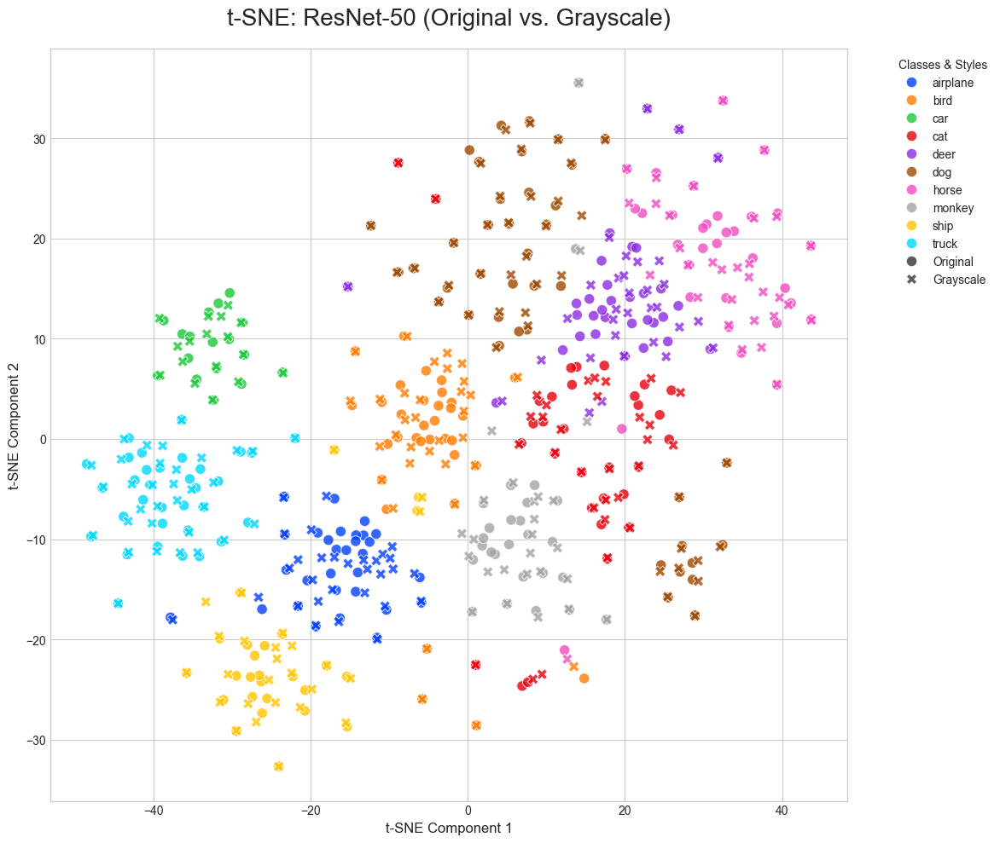

Running t-SNE for ViT: Original vs. Grayscale...


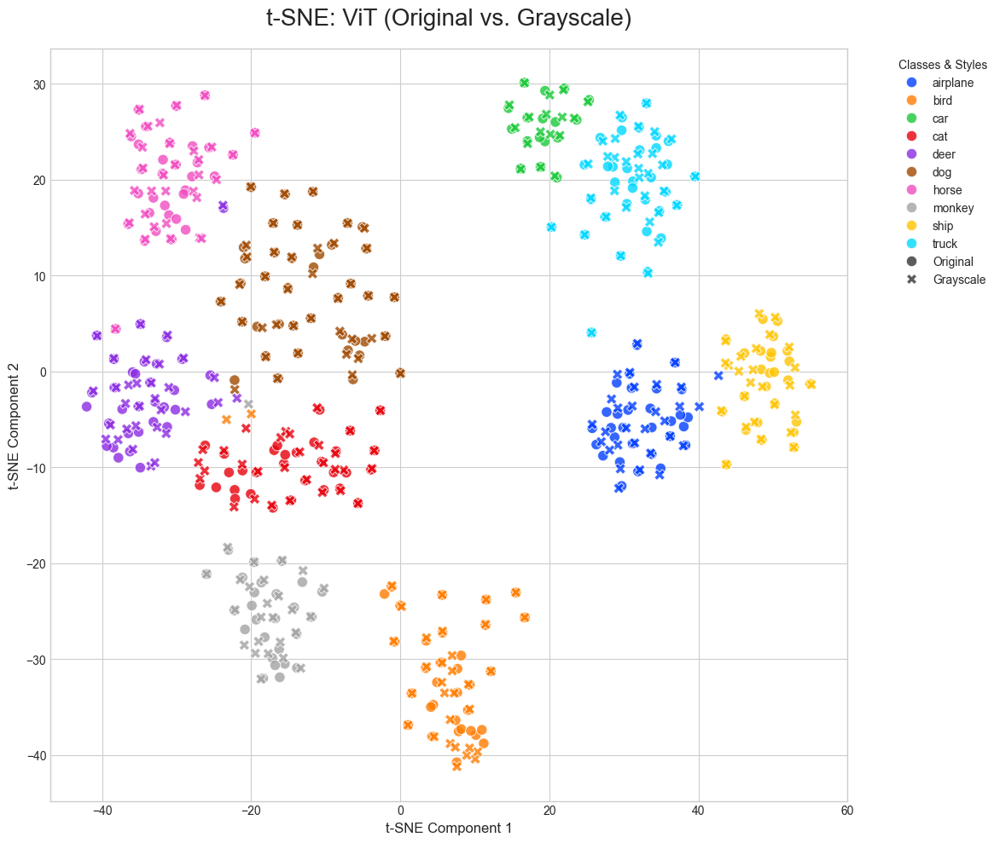

In [136]:
NUM_SAMPLES_PER_SET = 300
indices = list(range(len(test_dataset)))
random.shuffle(indices)
subset_indices = indices[:NUM_SAMPLES_PER_SET]

subset_test_loader = DataLoader(Subset(test_dataset, subset_indices), batch_size=64)
subset_grayscale_loader = DataLoader(Subset(grayscale_test_dataset, subset_indices), batch_size=64)

print("--- Extracting Features for ResNet-50 ---")
res_orig_feat, res_orig_lbl = extract_features(resnet, subset_test_loader, device, "ResNet-50", "Original")
res_gray_feat, res_gray_lbl = extract_features(resnet, subset_grayscale_loader, device, "ResNet-50", "Grayscale")

print("\n--- Extracting Features for ViT ---")
vit_orig_feat, vit_orig_lbl = extract_features(vit, subset_test_loader, device, "ViT", "Original")
vit_gray_feat, vit_gray_lbl = extract_features(vit, subset_grayscale_loader, device, "ViT", "Grayscale")

class_names = test_dataset.classes

def plot_tsne_comparison(features1, labels1, style1_name, features2, labels2, style2_name, model_name, class_names):
    """Applies t-SNE to TWO sets of features and creates a comparative plot."""
    all_features = np.concatenate([features1, features2])
    all_labels = np.concatenate([labels1, labels2])
    all_styles = [style1_name] * len(labels1) + [style2_name] * len(labels2)

    print(f"Running t-SNE for {model_name}: {style1_name} vs. {style2_name}...")
    tsne = TSNE(n_components=2, perplexity=30, max_iter=1000, random_state=42)
    tsne_results = tsne.fit_transform(all_features)

    plt.style.use("seaborn-v0_8-whitegrid")
    plt.figure(figsize=(14, 10))
    palette = sns.color_palette("bright", n_colors=len(class_names))
    markers = {style1_name: 'o', style2_name: 'X'}

    sns.scatterplot(
        x=tsne_results[:, 0], y=tsne_results[:, 1], hue=all_labels, style=all_styles,
        markers=markers, palette=palette, s=80, alpha=0.8, legend='full'
    )
    plt.title(f't-SNE: {model_name} ({style1_name} vs. {style2_name})', fontsize=20, pad=20)
    plt.xlabel('t-SNE Component 1', fontsize=12)
    plt.ylabel('t-SNE Component 2', fontsize=12)
    
    handles, labels = plt.gca().get_legend_handles_labels()
    
    class_handles = [h for h, l in zip(handles, labels) if l.isdigit()]
    style_handles = [h for h, l in zip(handles, labels) if l in markers.keys()]
    class_labels_str = [class_names[int(l)] for l in labels if l.isdigit()]
    style_labels_str = [l for l in labels if l in markers.keys()]
    
    plt.legend(handles=class_handles + style_handles, 
               labels=class_labels_str + style_labels_str, 
               title='Classes & Styles', 
               bbox_to_anchor=(1.05, 1), 
               loc='upper left')

    plt.tight_layout(rect=[0, 0, 0.85, 1])
    plt.show()

print("\n--- Generating Original vs. Grayscale Plots ---")
plot_tsne_comparison(res_orig_feat, res_orig_lbl, 'Original', res_gray_feat, res_gray_lbl, 'Grayscale', 'ResNet-50', class_names)
plot_tsne_comparison(vit_orig_feat, vit_orig_lbl, 'Original', vit_gray_feat, vit_gray_lbl, 'Grayscale', 'ViT', class_names)

### Domain Generalisation

In [4]:
from torch.utils.data import ConcatDataset
from sklearn.metrics import confusion_matrix
import pandas as pd
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.image import show_cam_on_image
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
import seaborn as sns


device = "cuda" if torch.cuda.is_available() else "cpu"
data_dir = "data/PACS"
train_domains = ['P', 'A', 'C']
test_domain = 'S'
NUM_CLASSES_PACS = 7
BATCH_SIZE = 128
LEARNING_RATE = 1e-3
EPOCHS = 5

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomResizedCrop(224, scale=(0.8, 1.0)), 
    transforms.RandomHorizontalFlip(), 
    transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])


train_datasets = [datasets.ImageFolder(os.path.join(data_dir, domain), transform=transform) for domain in train_domains]
combined_train_dataset = ConcatDataset(train_datasets)

test_dataset = datasets.ImageFolder(os.path.join(data_dir, test_domain), transform=transform)

train_loader = DataLoader(combined_train_dataset, batch_size=BATCH_SIZE, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

print(f"Combined training domains ({', '.join(train_domains)}): {len(combined_train_dataset)} images")
print(f"Test domain ({test_domain}): {len(test_dataset)} images")

class_names = test_dataset.classes

def imshow(inp, title=None):
    """Utility function to display a tensor as an image."""
    inp = inp.numpy().transpose((1, 2, 0))
    # Un-normalize the image
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title, fontsize=10)
    plt.axis('off')

Combined training domains (P, A, C): 6062 images
Test domain (S): 3929 images


In [5]:
resnet = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
for param in resnet.parameters():
    param.requires_grad = False
resnet.fc = nn.Linear(resnet.fc.in_features, NUM_CLASSES_PACS)
resnet = resnet.to(device)
resnet_optimizer = optim.Adam(resnet.fc.parameters(), lr=LEARNING_RATE)
criterion = nn.CrossEntropyLoss()

In [6]:
resnet_train_losses, resnet_test_losses = [], []
resnet_train_accs, resnet_test_accs = [], []

resnet_misclassified_samples = []
resnet_all_preds, resnet_all_targets = [], []

for epoch in range(EPOCHS):
    resnet.train()
    running_loss, correct_train, total_train = 0.0, 0, 0
    train_pbar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{EPOCHS} [ResNet Training]")
    for data, target in train_pbar:
        data, target = data.to(device), target.to(device)
        resnet_optimizer.zero_grad()
        output = resnet(data)
        loss = criterion(output, target)
        loss.backward()
        resnet_optimizer.step()

        running_loss += loss.item()
        _, predicted = torch.max(output.data, 1)
        total_train += target.size(0)
        correct_train += (predicted == target).sum().item()
        train_pbar.set_postfix({"loss": f"{running_loss/len(train_loader):.4f}", "acc": f"{100 * correct_train / total_train:.2f}%"})

    resnet_train_losses.append(running_loss / len(train_loader))
    resnet_train_accs.append(correct_train / total_train)

    resnet.eval()
    test_loss, correct_test, total_test = 0.0, 0, 0
    if epoch == EPOCHS - 1: # Collect samples only on the last epoch
        resnet_misclassified_samples.clear()
        resnet_all_preds.clear()
        resnet_all_targets.clear()

    with torch.no_grad():
        test_pbar = tqdm(test_loader, desc=f"Epoch {epoch+1}/{EPOCHS} [ResNet Testing]")
        for data, target in test_pbar:
            data, target = data.to(device), target.to(device)
            output = resnet(data)
            loss = criterion(output, target)
            test_loss += loss.item()
            _, predicted = torch.max(output.data, 1)
            total_test += target.size(0)
            correct_test += (predicted == target).sum().item()

            # Collect data for failure analysis on the final epoch
            if epoch == EPOCHS - 1:
                resnet_all_preds.extend(predicted.cpu().numpy())
                resnet_all_targets.extend(target.cpu().numpy())
                misclassified_mask = (predicted != target)
                if misclassified_mask.any():
                    for i in range(len(data[misclassified_mask])):
                        if len(resnet_misclassified_samples) < 25:
                            resnet_misclassified_samples.append({
                                "image": data[misclassified_mask][i].cpu(),
                                "pred": predicted[misclassified_mask][i].cpu().item(),
                                "true": target[misclassified_mask][i].cpu().item()
                            })

            test_pbar.set_postfix({"loss": f"{test_loss/len(test_loader):.4f}", "acc": f"{100 * correct_test / total_test:.2f}%"})

    resnet_test_losses.append(test_loss / len(test_loader))
    resnet_test_accs.append(correct_test / total_test)
    print(f"Epoch {epoch+1} Summary -> Train Acc: {resnet_train_accs[-1]*100:.2f}% | Test Acc: {resnet_test_accs[-1]*100:.2f}%")



Epoch 1/5 [ResNet Testing]: 100%|██████████| 31/31 [00:22<00:00,  1.41it/s, loss=1.5331, acc=45.97%]


Epoch 1 Summary -> Train Acc: 71.53% | Test Acc: 45.97%


Epoch 2/5 [ResNet Testing]: 100%|██████████| 31/31 [00:19<00:00,  1.61it/s, loss=1.4986, acc=45.38%]


Epoch 2 Summary -> Train Acc: 88.07% | Test Acc: 45.38%


Epoch 3/5 [ResNet Testing]: 100%|██████████| 31/31 [00:19<00:00,  1.58it/s, loss=1.3723, acc=49.38%]


Epoch 3 Summary -> Train Acc: 89.89% | Test Acc: 49.38%


Epoch 4/5 [ResNet Testing]: 100%|██████████| 31/31 [00:23<00:00,  1.31it/s, loss=1.3883, acc=48.51%]


Epoch 4 Summary -> Train Acc: 91.11% | Test Acc: 48.51%


Epoch 5/5 [ResNet Testing]: 100%|██████████| 31/31 [00:19<00:00,  1.61it/s, loss=1.3481, acc=50.17%]

Epoch 5 Summary -> Train Acc: 92.00% | Test Acc: 50.17%


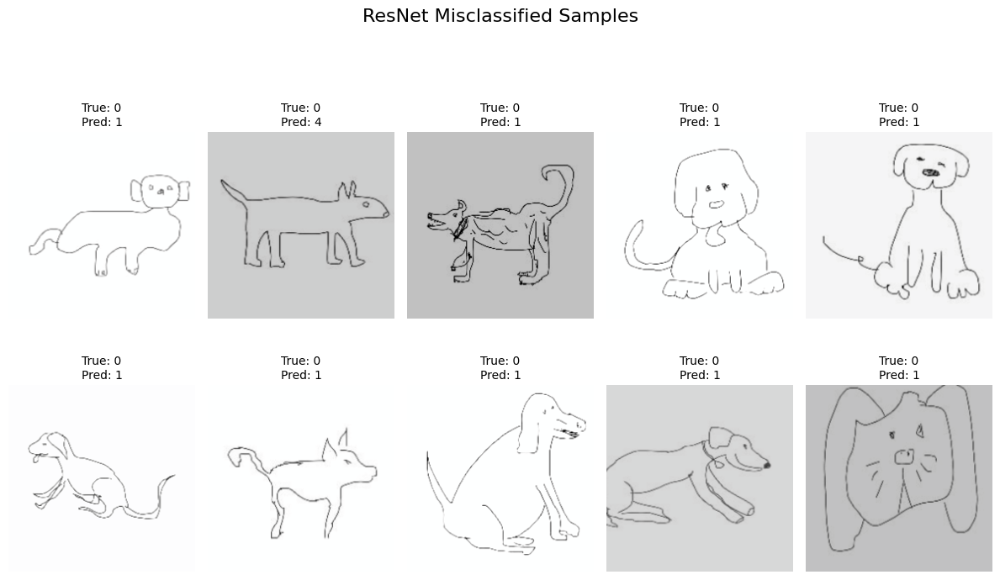

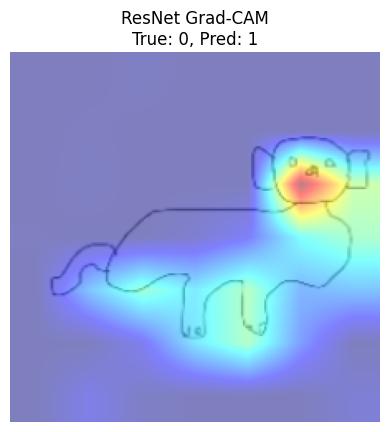

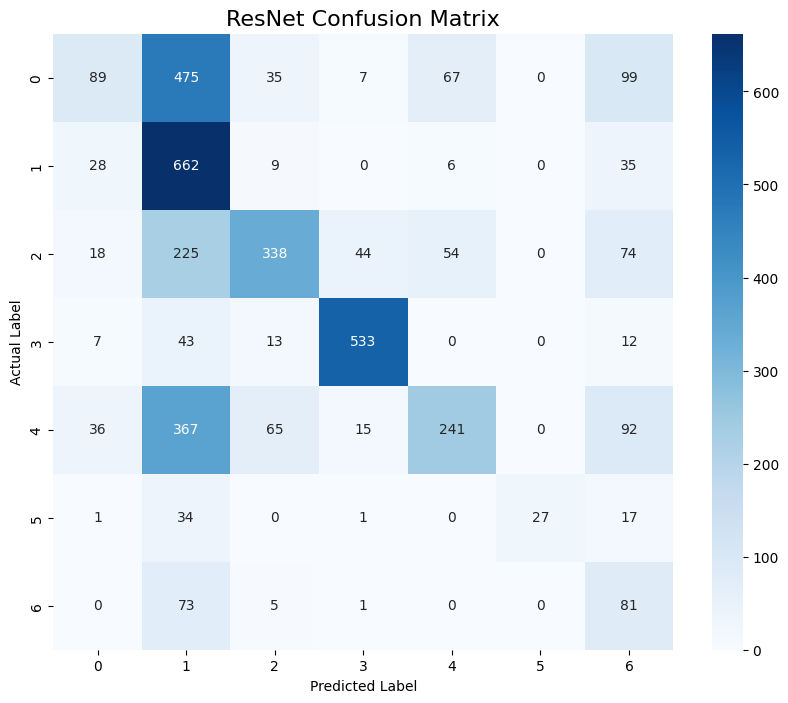

In [7]:
if resnet_misclassified_samples:
    fig = plt.figure(figsize=(12, 8))
    fig.suptitle("ResNet Misclassified Samples", fontsize=16)
    for i, sample in enumerate(resnet_misclassified_samples[:10]):
        ax = plt.subplot(2, 5, i + 1)
        title = f"True: {class_names[sample['true']]}\nPred: {class_names[sample['pred']]}"
        imshow(sample['image'], title)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

# 3.2. Grad-CAM Visualization
if resnet_misclassified_samples:
    # FIX: Manually unfreeze the model's parameters
    for param in resnet.parameters():
        param.requires_grad = True

    try:
        target_layer = [resnet.layer4[-1]]
        sample = resnet_misclassified_samples[0]
        input_tensor = sample['image'].unsqueeze(0).to(device)

        with GradCAM(model=resnet, target_layers=target_layer) as cam:
            targets = [ClassifierOutputTarget(sample['pred'])]
            grayscale_cam = cam(input_tensor=input_tensor, targets=targets)[0, :]
            
            rgb_img = sample['image'].numpy().transpose((1, 2, 0))
            mean, std = np.array([0.485, 0.456, 0.406]), np.array([0.229, 0.224, 0.225])
            rgb_img = std * rgb_img + mean
            rgb_img = np.clip(rgb_img, 0, 1)
            
            cam_image = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
        
        plt.imshow(cam_image)
        plt.title(f"ResNet Grad-CAM\nTrue: {class_names[sample['true']]}, Pred: {class_names[sample['pred']]}")
        plt.axis('off')
        plt.show()

    finally:
        # IMPORTANT: Re-freeze the model to its original state
        for param in resnet.parameters():
            param.requires_grad = False
        # Only the classifier head should be trainable
        for param in resnet.fc.parameters():
            param.requires_grad = True
# 3.3. Confusion Matrix
cm = confusion_matrix(resnet_all_targets, resnet_all_preds)
cm_df = pd.DataFrame(cm, index=class_names, columns=class_names)
plt.figure(figsize=(10, 8))
sns.heatmap(cm_df, annot=True, fmt='d', cmap='Blues')
plt.title('ResNet Confusion Matrix', fontsize=16)
plt.ylabel('Actual Label')
plt.xlabel('Predicted Label')
plt.show()


In [34]:
BATCH_SIZE = 128
LEARNING_RATE = 4e-4
EPOCHS = 10

vit = timm.create_model('vit_small_patch16_224', pretrained=True)
for param in vit.parameters():
    param.requires_grad = False
for param in vit.blocks[-1].parameters(): 
    param.requires_grad = True
vit.head = nn.Linear(vit.head.in_features, NUM_CLASSES_PACS)
vit = vit.to(device)

trainable_params = [p for p in vit.parameters() if p.requires_grad]
vit_optimizer = optim.Adam(trainable_params, lr=LEARNING_RATE, weight_decay=1e-4)

criterion = nn.CrossEntropyLoss()

In [35]:
vit_train_losses, vit_test_losses = [], []
vit_train_accs, vit_test_accs = [], []

vit_misclassified_samples = []
vit_all_preds, vit_all_targets = [], []

for epoch in range(EPOCHS):
    vit.train()
    running_loss, correct_train, total_train = 0.0, 0, 0
    train_pbar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{EPOCHS} [ViT Training]")
    for data, target in train_pbar:
        data, target = data.to(device), target.to(device)
        vit_optimizer.zero_grad()
        output = vit(data)
        loss = criterion(output, target)
        loss.backward()
        vit_optimizer.step()

        running_loss += loss.item()
        _, predicted = torch.max(output.data, 1)
        total_train += target.size(0)
        correct_train += (predicted == target).sum().item()
        train_pbar.set_postfix({"loss": f"{running_loss/len(train_loader):.4f}", "acc": f"{100 * correct_train / total_train:.2f}%"})

    vit_train_losses.append(running_loss / len(train_loader))
    vit_train_accs.append(correct_train / total_train)

    vit.eval()
    test_loss, correct_test, total_test = 0.0, 0, 0
    
    if epoch == EPOCHS - 1:
        vit_misclassified_samples.clear()
        vit_all_preds.clear()
        vit_all_targets.clear()
        
    with torch.no_grad():
        test_pbar = tqdm(test_loader, desc=f"Epoch {epoch+1}/{EPOCHS} [ViT Testing]")
        for data, target in test_pbar:
            data, target = data.to(device), target.to(device)
            output = vit(data)
            loss = criterion(output, target)
            test_loss += loss.item()
            _, predicted = torch.max(output.data, 1)
            total_test += target.size(0)
            correct_test += (predicted == target).sum().item()
            
            if epoch == EPOCHS - 1:
                vit_all_preds.extend(predicted.cpu().numpy())
                vit_all_targets.extend(target.cpu().numpy())
                misclassified_mask = (predicted != target)
                if misclassified_mask.any():
                    for i in range(len(data[misclassified_mask])):
                        if len(vit_misclassified_samples) < 25:
                            vit_misclassified_samples.append({
                                "image": data[misclassified_mask][i].cpu(),
                                "pred": predicted[misclassified_mask][i].cpu().item(),
                                "true": target[misclassified_mask][i].cpu().item()
                            })
                            
            test_pbar.set_postfix({"loss": f"{test_loss/len(test_loader):.4f}", "acc": f"{100 * correct_test / total_test:.2f}%"})

    vit_test_losses.append(test_loss / len(test_loader))
    vit_test_accs.append(correct_test / total_test)
    print(f"Epoch {epoch+1} Summary -> Train Acc: {vit_train_accs[-1]*100:.2f}% | Test Acc: {vit_test_accs[-1]*100:.2f}%")


Epoch 1/10 [ViT Testing]: 100%|██████████| 31/31 [00:45<00:00,  1.48s/it, loss=2.2728, acc=27.00%]


Epoch 1 Summary -> Train Acc: 79.84% | Test Acc: 27.00%


Epoch 2/10 [ViT Testing]: 100%|██████████| 31/31 [00:44<00:00,  1.44s/it, loss=2.0115, acc=33.01%]


Epoch 2 Summary -> Train Acc: 92.26% | Test Acc: 33.01%


Epoch 3/10 [ViT Testing]: 100%|██████████| 31/31 [00:44<00:00,  1.45s/it, loss=2.0930, acc=35.58%]


Epoch 3 Summary -> Train Acc: 94.44% | Test Acc: 35.58%


Epoch 4/10 [ViT Testing]: 100%|██████████| 31/31 [00:26<00:00,  1.16it/s, loss=1.9174, acc=38.69%]


Epoch 4 Summary -> Train Acc: 95.55% | Test Acc: 38.69%


Epoch 5/10 [ViT Testing]: 100%|██████████| 31/31 [00:44<00:00,  1.43s/it, loss=1.9420, acc=40.39%]


Epoch 5 Summary -> Train Acc: 95.65% | Test Acc: 40.39%


Epoch 6/10 [ViT Testing]: 100%|██████████| 31/31 [00:44<00:00,  1.43s/it, loss=2.1166, acc=36.55%]


Epoch 6 Summary -> Train Acc: 96.60% | Test Acc: 36.55%


Epoch 7/10 [ViT Testing]: 100%|██████████| 31/31 [00:46<00:00,  1.49s/it, loss=1.8470, acc=42.02%]


Epoch 7 Summary -> Train Acc: 97.71% | Test Acc: 42.02%


Epoch 8/10 [ViT Testing]: 100%|██████████| 31/31 [00:45<00:00,  1.47s/it, loss=2.5082, acc=36.04%]


Epoch 8 Summary -> Train Acc: 97.66% | Test Acc: 36.04%


Epoch 9/10 [ViT Testing]: 100%|██████████| 31/31 [00:41<00:00,  1.35s/it, loss=2.4553, acc=36.19%]


Epoch 9 Summary -> Train Acc: 97.62% | Test Acc: 36.19%


Epoch 10/10 [ViT Testing]: 100%|██████████| 31/31 [00:38<00:00,  1.24s/it, loss=2.1281, acc=38.18%]

Epoch 10 Summary -> Train Acc: 97.90% | Test Acc: 38.18%


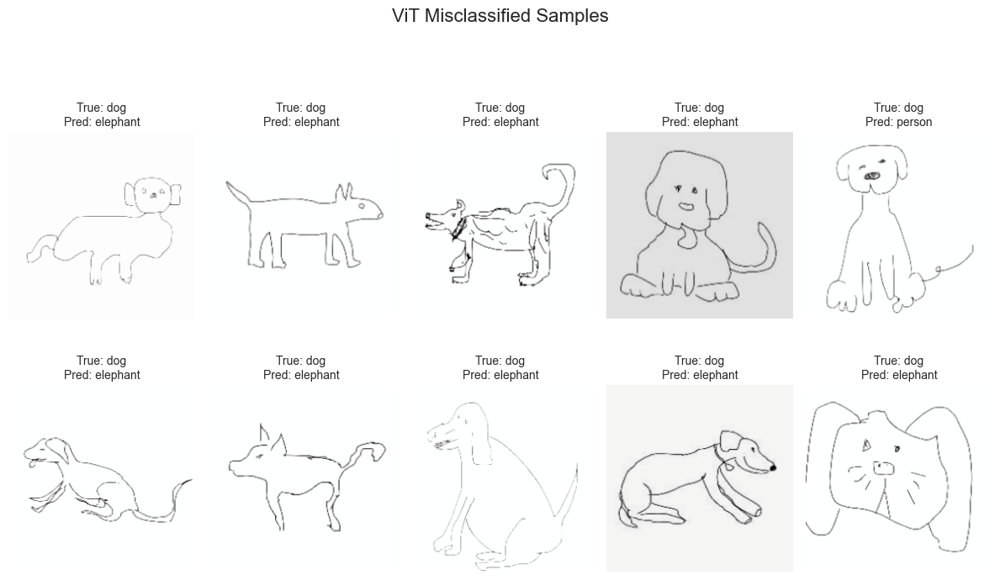

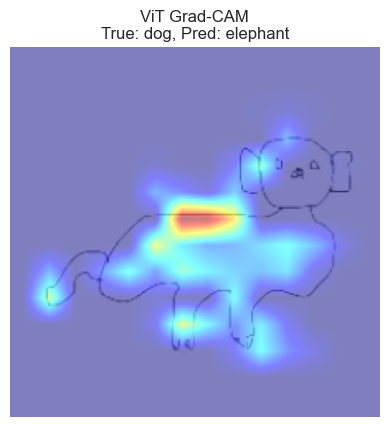

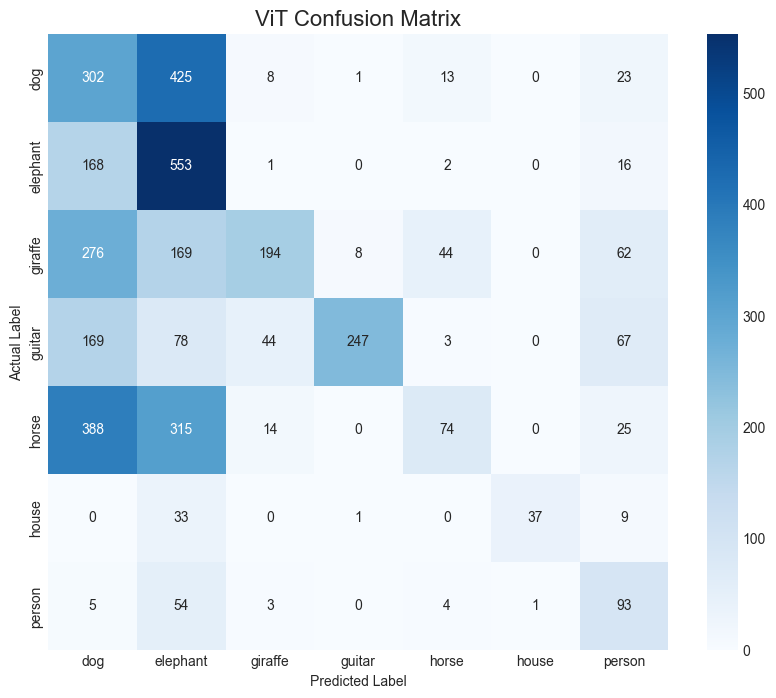

In [36]:
class_names = ['dog', 'elephant', 'giraffe', 'guitar', 'horse', 'house', 'person']

def reshape_transform(tensor, height=14, width=14):
    result = tensor[:, 1:, :]
    
    result = result.reshape(tensor.size(0), height, width, tensor.size(2))
    
    result = result.permute(0, 3, 1, 2)
    return result

if vit_misclassified_samples:
    fig = plt.figure(figsize=(12, 8))
    fig.suptitle("ViT Misclassified Samples", fontsize=16)
    for i, sample in enumerate(vit_misclassified_samples[:10]):
        ax = plt.subplot(2, 5, i + 1)
        title = f"True: {class_names[sample['true']]}\nPred: {class_names[sample['pred']]}"
        imshow(sample['image'], title)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

if vit_misclassified_samples:
    # 2. Temporarily unfreeze the model to allow gradient flow
    for param in vit.parameters():
        param.requires_grad = True
    
    try:
        target_layer = [vit.blocks[-1].norm1]
        sample = vit_misclassified_samples[0]
        input_tensor = sample['image'].unsqueeze(0).to(device)

        # 3. Use the reshape_transform in the GradCAM constructor
        with GradCAM(model=vit, 
                     target_layers=target_layer, 
                     reshape_transform=reshape_transform) as cam:
                     
            targets = [ClassifierOutputTarget(sample['pred'])]
            grayscale_cam = cam(input_tensor=input_tensor, targets=targets)[0, :]
            
            # ... rest of your plotting code ...
            rgb_img = sample['image'].numpy().transpose((1, 2, 0))
            mean, std = np.array([0.485, 0.456, 0.406]), np.array([0.229, 0.224, 0.225])
            rgb_img = std * rgb_img + mean
            rgb_img = np.clip(rgb_img, 0, 1)
            cam_image = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)

        plt.imshow(cam_image)
        plt.title(f"ViT Grad-CAM\nTrue: {class_names[sample['true']]}, Pred: {class_names[sample['pred']]}")
        plt.axis('off')
        plt.show()

    finally:
        # 4. IMPORTANT: Restore the model to its original frozen state
        for param in vit.parameters():
            param.requires_grad = False
        for param in vit.head.parameters():
            param.requires_grad = True

cm = confusion_matrix(vit_all_targets, vit_all_preds)
cm_df = pd.DataFrame(cm, index=class_names, columns=class_names)
plt.figure(figsize=(10, 8))
sns.heatmap(cm_df, annot=True, fmt='d', cmap='Blues')
plt.title('ViT Confusion Matrix', fontsize=16)
plt.ylabel('Actual Label')
plt.xlabel('Predicted Label')
plt.show()

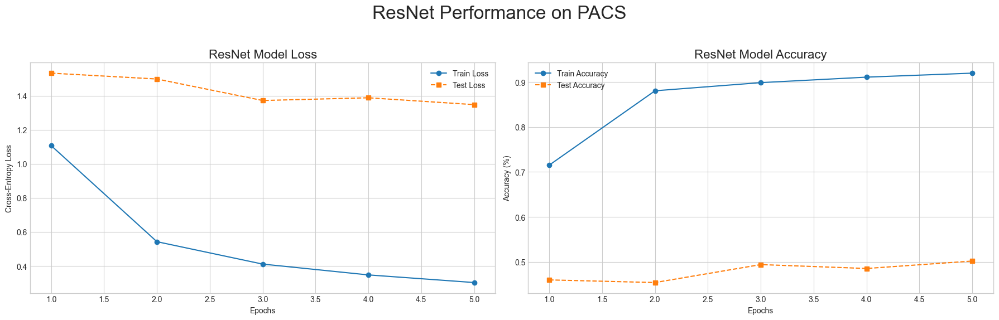

In [8]:
plt.style.use("seaborn-v0_8-whitegrid")
fig_resnet, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6)) # 1 row, 2 columns

fig_resnet.suptitle("ResNet Performance on PACS", fontsize=24)
epochs_resnet_range = range(1, 5 + 1)
# ResNet Loss Plot
ax1.plot(epochs_resnet_range, resnet_train_losses, "o-", label="Train Loss")
ax1.plot(epochs_resnet_range, resnet_test_losses, "s--", label="Test Loss")
ax1.set_title("ResNet Model Loss", fontsize=16)
ax1.set_xlabel("Epochs")
ax1.set_ylabel("Cross-Entropy Loss")
ax1.legend()

# ResNet Accuracy Plot
ax2.plot(epochs_resnet_range, resnet_train_accs, "o-", label="Train Accuracy")
ax2.plot(epochs_resnet_range, resnet_test_accs, "s--", label="Test Accuracy")
ax2.set_title("ResNet Model Accuracy", fontsize=16)
ax2.set_xlabel("Epochs")
ax2.set_ylabel("Accuracy (%)")
ax2.legend()

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


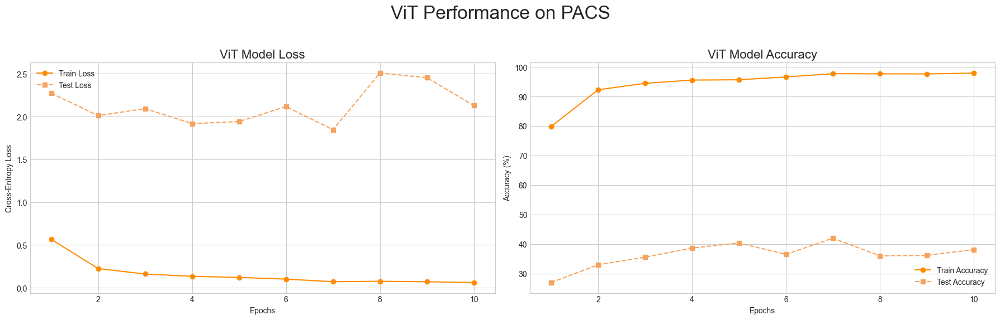

In [38]:
EPOCHS_VIT = 10

plt.style.use("seaborn-v0_8-whitegrid")
fig_vit, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))
fig_vit.suptitle("ViT Performance on PACS", fontsize=24)
epochs_vit_range = range(1, EPOCHS_VIT + 1)

# ViT Loss Plot
ax1.plot(epochs_vit_range, vit_train_losses, "o-", label="Train Loss", color="darkorange")
ax1.plot(epochs_vit_range, vit_test_losses, "s--", label="Test Loss", color="sandybrown")
ax1.set_title("ViT Model Loss", fontsize=16)
ax1.set_xlabel("Epochs")
ax1.set_ylabel("Cross-Entropy Loss")
ax1.legend()

# ViT Accuracy Plot
ax2.plot(epochs_vit_range, [acc * 100 for acc in vit_train_accs], "o-", label="Train Accuracy", color="darkorange")
ax2.plot(epochs_vit_range, [acc * 100 for acc in vit_test_accs], "s--", label="Test Accuracy", color="sandybrown")
ax2.set_title("ViT Model Accuracy", fontsize=16)
ax2.set_xlabel("Epochs")
ax2.set_ylabel("Accuracy (%)")
ax2.legend()

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()